# Noise reduction 
 
The algorithm in noisereduce is based on (but not completely reproducing) on the one outlined by Audacity for the noise reduction effect (Link to C++ code).
The algorithm noisereduce required two input file: the noise signal and the signal audio clip. However, in the reality, we do not often have the noise signal, thus below will used a technique called sound envelope to create our own noise signal clip. 

#### Create noise file:
* In Audacity, it is required for us to select the noise part (when human voice are not appeared) manually. In this section, a sound envelope is used here.  

#### noisereduce algorithm 

1. An Short-time Fourier Transforamtion is calculated over the noise audio clip
2. Statistics are calculated over FFT of the the noise (in frequency: mean, standard deviation, noise threshold)
3. A threshold is calculated based upon the statistics of the noise (and the desired sensitivity of the algorithm). How many standard deviations louder than the mean dB of the noise (at each frequency level) to be considered signal.
4. An STFT is calculated over the signal
5. A mask is determined by comparing the signal FFT to the threshold
6. The mask is smoothed with a filter over frequency and time
7. Calculate the threshold for each frequency/time bin, if the signal is above threshold --> convolve the mask with a smoothing filter with scipy.signal.fftconvolve
8. The mask is applied to the FFT of the signal, and is inverted with Inverse short time Fourier Transform (ISTFT) 

Full script: https://timsainburg.com/noise-reduction-python.html

In [1]:
# import neccessary libraries
import os, io
import shutil
import  joblib
import numpy as np
import pandas as pd
import librosa as lb
import librosa.display
import matplotlib.pyplot as plt

from pathlib import Path
from tqdm.notebook import tqdm
import IPython.display

import noisereduce as nr
from matplotlib import pyplot as plt
from scipy.ndimage import maximum_filter1d
import IPython
from scipy.io import wavfile
import scipy.signal
import numpy as np
import matplotlib.pyplot as plt
import librosa
import soundfile as sf
%matplotlib inline

/Users/michliu/opt/anaconda3/lib/python3.7/site-packages/noisereduce/noisereduce.py:5: TqdmExperimentalWarning: Using `tqdm.autonotebook.tqdm` in notebook mode. Use `tqdm.tqdm` instead to force console mode (e.g. in jupyter console)
  from tqdm.autonotebook import tqdm


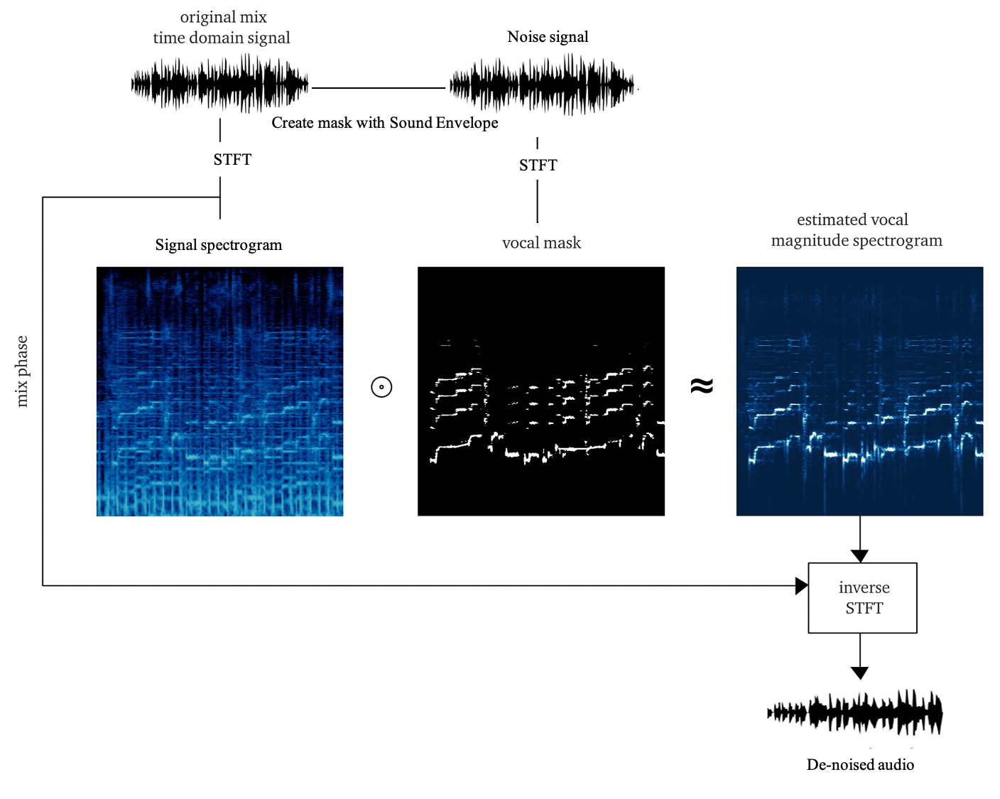

In [2]:
IPython.display.Image("/Users/michliu/Documents/HSBC - Data scientist/image/noise_reduce.png")

## Project Set-up

In [209]:
# create directories

#os.makedirs("/Users/michliu/Documents/HSBC - Data scientist/audio/cantonese2/transcription/")
#os.makedirs("/Users/michliu/Documents/HSBC - Data scientist/audio/cantonese2/Processed_train/")
#os.makedirs("/Users/michliu/Documents/HSBC - Data scientist/audio/cantonese2/Processed_train_louder/")
#os.makedirs("/Users/michliu/Documents/HSBC - Data scientist/audio/cantonese2/Processed_train_louder_slower/")

In [2]:
# Path for files
AUDIO_ROOT = Path("/Users/michliu/Documents/HSBC - Data scientist/audio/cantonese2/transcript")
CLEAN_AUDIO_ROOT = Path("/Users/michliu/Documents/HSBC - Data scientist/audio/cantonese2/clean_train/")
NOISE_AUDIO_ROOT = Path("/Users/michliu/Documents/HSBC - Data scientist/audio/cantonese2/Noise_training/")
NOISY_AUDIO_ROOT = Path("/Users/michliu/Documents/HSBC - Data scientist/audio/cantonese2/NoisySpeech_training/")
PROCESSED_AUDIO_ROOT = Path("/Users/michliu/Documents/HSBC - Data scientist/audio/cantonese2/Processed_train/")
PROCESSED_AUDIO_LOUD_ROOT = Path("/Users/michliu/Documents/HSBC - Data scientist/audio/cantonese2/Processed_train_louder/")
PROCESSED_AUDIO_LOUD_SLOW_ROOT = Path("/Users/michliu/Documents/HSBC - Data scientist/audio/cantonese2/Processed_train_louder_slower/")
TRANSCRIPT_PATH = "/Users/michliu/Documents/HSBC - Data scientist/audio/cantonese2/transcription/"

In [3]:
# Set up a params class 
class params:
    """
    Parameters used for the audio data
    """
    sr = 44100 # sample rate
    thr = 0.25 # hyperparameter: threshold - how many standard deviations louder than the mean dB of the noise (at each frequency level) to be considered signal
    prop_dec = 0.5 # Hyperparameter: prop-decrease - To what extent should you decrease noise (1 = all, 0 = none)

# Function to read and load audio file
def load_audio(record, sr, root=""):
    y, _ = lb.load(
        root.joinpath(record).with_suffix(".wav").as_posix(),
        sr=sr, 
    )
    return y

# Function to read audio
def audioread(path, norm = True, start=0, stop=None):
    path = os.path.abspath(path)
    if not os.path.exists(path):
        raise ValueError("[{}] does not exist!".format(path))
    try:
        x, sr = sf.read(path, start=start, stop=stop)
    except RuntimeError:  # fix for sph pcm-embedded shortened v2
        print('WARNING: Audio type not supported')

    if len(x.shape) == 1:  # mono
        if norm:
            rms = (x ** 2).mean() ** 0.5
            scalar = 10 ** (-25 / 20) / (rms)
            x = x * scalar
        return x, sr
    else:  # multi-channel
        x = x.T
        x = x.sum(axis=0)/x.shape[0]
        if norm:
            rms = (x ** 2).mean() ** 0.5
            scalar = 10 ** (-25 / 20) / (rms)
            x = x * scalar
        return x, sr
    
    
# Funtion to write audio    
def audiowrite(data, fs, destpath, norm=False):
    if norm:
        rms = (data ** 2).mean() ** 0.5
        scalar = 10 ** (-25 / 10) / (rms+eps)
        data = data * scalar
        if max(abs(data))>=1:
            data = data/max(abs(data), eps)
    
    destpath = os.path.abspath(destpath)
    destdir = os.path.dirname(destpath)
    
    if not os.path.exists(destdir):
        os.makedirs(destdir)
    
    sf.write(destpath, data, fs)
    return
    

## What is Sound Envelope?

The envelope of a sound displays how the level of a sound wave changes over time. If the level of sound is too low we will remove that part. 

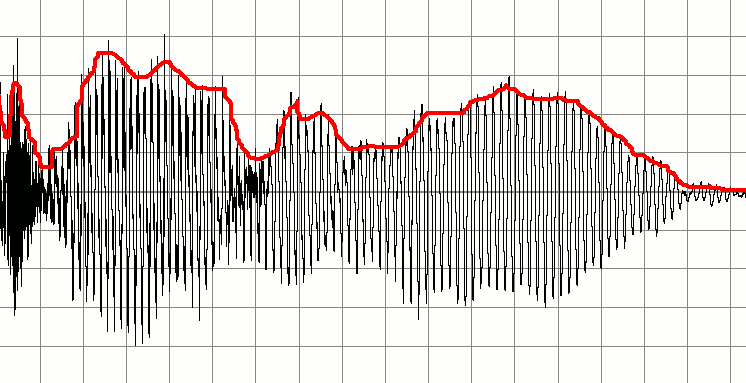

In [212]:
IPython.display.Image("/Users/michliu/Documents/HSBC - Data scientist/image/sound_envelope.png")

#### Sound Envelope (Red Line)

But how we will see if that sound level is low?
- For that we will form a threshold and everything below that threshold will be considered as unwanted noise.
- A rolling window will be passed through the audio waveform and mean will be taken.
- If that mean is less then threshold value then remove that unwanted audio

Source: https://www.kaggle.com/jainarindam/imp-remove-background-dead-noise

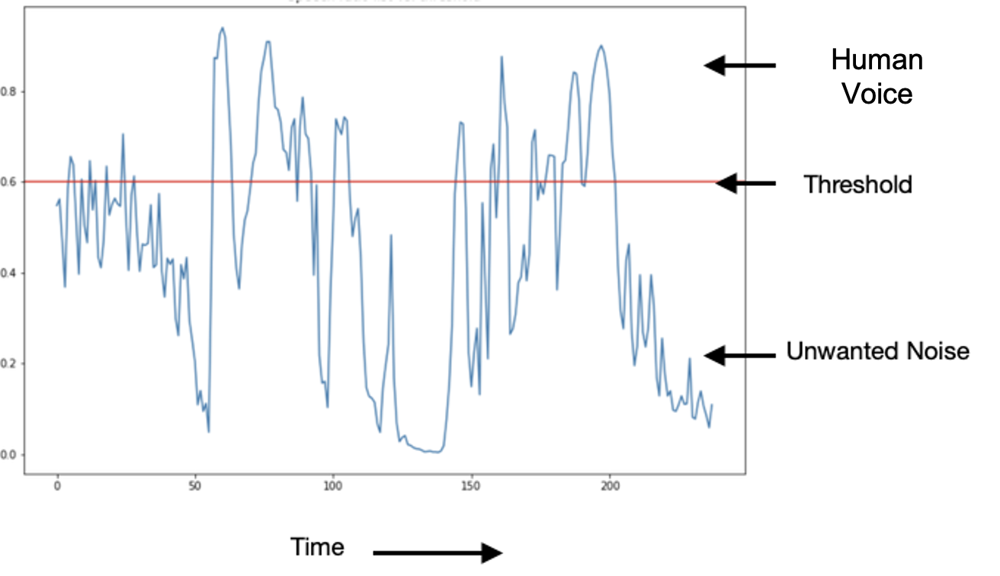

In [213]:
IPython.display.Image("/Users/michliu/Documents/HSBC - Data scientist/image/sound_envelope3.png")
# For example

In [4]:
# Create Sound Envelope
def envelope(y, rate, threshold):
    mask = []
    y = pd.Series(y).apply(np.abs)
    y_mean = y.rolling(window=int(rate/20),min_periods=1,center=True).max()
    for mean in y_mean:
        if mean > threshold:
            mask.append(True)
        else:
            mask.append(False)
    return mask, y_mean

# Window size and threshold are hyperparameters.
# The higher the threshold, might remove human voice as well, so there is a trade-off to make it optimal.

## Evaluation: Google Cloud Speech-to-text API

Google Cloud Speech-to-text API are the only few API resources that are available for long audio (i.e. more than 10 minutes), which is common audio length in the call center. For audio length longer than 1 minute, it is required to upload the data to Google cloud (Asynchronous Request). In the following, we will use Asynchronous Request for audio less than 1 minute to quickly check the performance of the Noise Reduction Algorithm.

Output of the API:
* Transcript: Is the output of the text that the model returns (what the machine understood from the audio file).
* Confidence: Is a value between 0-1 that the api returns for each transcription that (assumptively) equals the confidentiality/accuracy of the model in the prediction it made (how sure the machine is that it understood correctly).


In [5]:
# To use Google Cloud API, we need to first connect to my google application credentials
os.environ['GOOGLE_APPLICATION_CREDENTIALS'] = r'/Users/michliu/Downloads/practical-mason-310116-d58cfab8b943.json'


In [7]:
# Cantonese Speech-to-text API: data from local directory 
def transcribe_gcs(path, speech_file, sample_rate = 44100):
    """Asynchronously transcribes the audio file specified by the gcs_uri."""
    from google.cloud import speech

    client = speech.SpeechClient()
    
    path = os.path.join(path, speech_file)
    with io.open(path, "rb") as audio_file:
        content = audio_file.read()

    audio = speech.RecognitionAudio(content=content)
    config = speech.RecognitionConfig(
        encoding=speech.RecognitionConfig.AudioEncoding.LINEAR16,
        sample_rate_hertz=sample_rate,
        audio_channel_count=1,
        max_alternatives = 1,
        # speech_contexts = [信用卡`]
        language_code='yue-Hant-HK')
    
    operation = client.long_running_recognize(config=config, audio=audio)

    print("Waiting for operation to complete...")
    response = operation.result(timeout=1500)

    # Each result is for a consecutive portion of the audio. Iterate through
    # them to get the transcripts for the entire audio file.
    for result in response.results:
        # The first alternative is the most likely one for this portion.
        print(u"Transcript: {}".format(result.alternatives[0].transcript))
        print("Confidence: {}".format(result.alternatives[0].confidence))
        #print("Channel Tag: ", result.channel_tag)
        
    results = response.results
    # Write transcript in folder
    raw_text_file = open( (str(TRANSCRIPT_PATH + speech_file.split(".")[0]))  + '.txt', 'w')
    for result in results:
        for alternative in result.alternatives:
            raw_text_file.write(alternative.transcript + '\n')
    raw_text_file.close() #output raw text file of transcription

        
    return 


In [8]:
# Cantonese Speech-to-text API: data from google cloud
def transcribe_gcs_google_cloud(gcs_uri):
    """Asynchronously transcribes the audio file specified by the gcs_uri."""
    from google.cloud import speech

    client = speech.SpeechClient()

    audio = speech.RecognitionAudio(uri=gcs_uri)
    config = speech.RecognitionConfig(
        encoding=speech.RecognitionConfig.AudioEncoding.FLAC,
        sample_rate_hertz=44100,
        audio_channel_count=1,
        max_alternatives = 1,
        language_code='yue-Hant-HK')
    

    operation = client.long_running_recognize(config=config, audio=audio)

    print("Waiting for operation to complete...")
    response = operation.result(timeout=300)

    # Each result is for a consecutive portion of the audio. Iterate through
    # them to get the transcripts for the entire audio file.
    for result in response.results:
        # The first alternative is the most likely one for this portion.
        print(u"Transcript: {}".format(result.alternatives[0].transcript))
        print("Confidence: {}".format(result.alternatives[0].confidence))
        print("Channel Tag: ", result.channel_tag)
        
    results = response.results

    raw_text_file = open( r"/Users/michliu/Documents/job application/headhunt/HSBC - Data scientist/transcribe/audio1"  + '.txt', 'w')
    for result in results:
        for alternative in result.alternatives:
            raw_text_file.write(alternative.transcript + '\n')
    raw_text_file.close() #output raw text file of transcription
        
    return 

## Read audio files

In [9]:
# read noisy audio files
df_audio = pd.DataFrame({
    "recording_id": [path.stem for path in Path(NOISY_AUDIO_ROOT).glob("*.wav")],
})
df_audio.head()

,recording_id
0,noisy_Cantonese4_SNRdb_30_Restaurant_1
1,noisy_Cantonese3_SNRdb_10_Bus_1
2,noisy_Cantonese3_SNRdb_0_Park_1
3,noisy_Cantonese7_SNRdb_0_Typing_5
4,noisy_Cantonese2_SNRdb_30_Park_1


In [10]:
# read clean audio files
clean_audio = pd.DataFrame({
    "recording_id": [path.stem for path in Path(CLEAN_AUDIO_ROOT).glob("*.wav")],
})
clean_audio.head()

,recording_id
0,Cantonese1
1,Cantonese3
2,Cantonese2
3,Cantonese6
4,Cantonese7


In [11]:
# read noise audio files
noise_audio = pd.DataFrame({
    "recording_id": [path.stem for path in Path(NOISE_AUDIO_ROOT).glob("*.wav")],
})
noise_audio.head()

,recording_id
0,noisy_Cantonese4_SNRdb_30_Restaurant_1
1,noisy_Cantonese3_SNRdb_10_Bus_1
2,noisy_Cantonese3_SNRdb_0_Park_1
3,noisy_Cantonese7_SNRdb_0_Typing_5
4,noisy_Cantonese2_SNRdb_30_Park_1


## Output: De-noise all audios

In [227]:
processedspeech_dir = "/Users/michliu/Documents/HSBC - Data scientist/audio/cantonese2/Processed_train/"
louder_processedspeech_dir = "/Users/michliu/Documents/HSBC - Data scientist/audio/cantonese2/Processed_train_louder/"

In [228]:
total_samples = len(df_audio)
print('total_samples', total_samples)
thr = 0.25
#num_samples = 0
    
for i in range(0,total_samples):
    y = load_audio(df_audio["recording_id"][i], params.sr, NOISY_AUDIO_ROOT)
    
    mask, env = envelope(y, params.sr, thr)
    y_denoise = nr.reduce_noise(audio_clip=y, noise_clip=y[np.logical_not(mask)], verbose=False)
    filename = 'pr_'+df_audio["recording_id"][i]+'.wav'

    path = os.path.join(processedspeech_dir, filename)
    audiowrite(y_denoise, params.sr, path, norm=False)


total_samples 290


In [229]:
cwd = os.getcwd()
cwd

'/Users/michliu/Documents/HSBC - Data scientist/audio/cantonese2'

### Output: a. Increase output audio volume

Due to the worse performance from the Speech-to-text API for the de-noised audio, I would like to explore if there are any ways to improve the transcription. 

When we listen to both the noisy audio and de-noised audio, it is obvious that the de-noised audio has a much lower volume. So in the below function, the volume of the de-noised audio are increased to test the performance

In [230]:
os. chdir('/Users/michliu/Documents/HSBC - Data scientist/audio/cantonese2/Processed_train_louder/') 

In [231]:
# function to increase audio volume
from pydub import AudioSegment
def increase_audio_volume(filename):
    # Import audio file 
    wav_file = AudioSegment.from_file(filename) 
    # Increase by 10 decibels 
    louder_wav_file = wav_file + 10
    # Export louder audio file 
    
    filename_ = filename.split("/")[-1].split('.')[0]
   # print(filename_)

    louder_wav_file.export(out_f =  str(filename_) + "_10" + ".wav", 
                       format = "wav")

In [232]:
# read processed audio files
processed_audio = pd.DataFrame({
    "recording_id": [path.stem for path in Path(PROCESSED_AUDIO_ROOT).glob("*.wav")],
})
processed_audio.head()

,recording_id
0,pr_noisy_Cantonese3_SNRdb_40_AirportAnnounceme...
1,pr_noisy_Cantonese5_SNRdb_30_CopyMachine_2
2,pr_noisy_Cantonese2_SNRdb_30_WasherDryer_1
3,pr_noisy_Cantonese4_SNRdb_0_Babble_1
4,pr_noisy_Cantonese2_SNRdb_20_SqueakyChair_1


In [233]:
# Run increase_audio_volume function to increase volume of processed audio file 
for i in range(0, len(processed_audio)): 
    file_name = "/Users/michliu/Documents/HSBC - Data scientist/audio/cantonese2/Processed_train/" + processed_audio["recording_id"][i] +".wav"
    increase_audio_volume(file_name)

### Output: b. Slowdown output audio

We can see a slight improve in the perofrmance by increasing the volume for the de-noised audio. To further improve the performace, I 

In [235]:
# function to slowdown the audio
import wave
import scipy.signal as sps
def slow_down_audio(filename):
    channels = 1
    swidth = 2
    multiplier = 0.90 # slow by 10%

    spf = wave.open(filename, 'rb')
    fr=spf.getframerate() # frame rate
    signal = spf.readframes(-1)
    
    filename_ = filename.split("/")[-1].split('.')[0]

    wf = wave.open(str(filename_) + "_s" + ".wav", 'wb')
    wf.setnchannels(channels)
    wf.setsampwidth(swidth)
    wf.setframerate(fr*multiplier)
    wf.writeframes(signal)
    wf.close()


In [236]:
# read processed loud audio files
processed_audio_loud = pd.DataFrame({
    "recording_id": [path.stem for path in Path(PROCESSED_AUDIO_LOUD_ROOT).glob("*.wav")],
})
processed_audio_loud.head()

,recording_id
0,pr_noisy_Cantonese7_SNRdb_10_Hallway_1_10
1,pr_noisy_Cantonese2_SNRdb_20_SqueakyChair_1_10
2,pr_noisy_Cantonese4_SNRdb_0_Babble_1_10
3,pr_noisy_Cantonese5_SNRdb_30_Hallway_1_10
4,pr_noisy_Cantonese3_SNRdb_40_Bus_1_10


In [234]:
os. chdir('/Users/michliu/Documents/HSBC - Data scientist/audio/cantonese2/Processed_train_louder_slower/') 

In [237]:
# Run increase_audio_volume function to increase volume of processed audio file 
for i in range(0, len(processed_audio_loud)): 
    file_name = "/Users/michliu/Documents/HSBC - Data scientist/audio/cantonese2/Processed_train_louder/" + processed_audio_loud["recording_id"][i] +".wav"
    #print(file_name)
    slow_down_audio(file_name)

In [12]:
os. chdir('/Users/michliu/Documents/HSBC - Data scientist/audio/cantonese2/') 

##### !! Main code ends. There are only examples below !!

## Four examples are demonstrated below to evaluate the performance:
* 2 examples for stationary noise (Washer Dryer, Air-conditioner)
* 2 examples for non-stationary noise (Keyboard typing, noisy restaurant)

### Example 1 - Stationary noise (WasherDryer)

In [13]:
# find audios index with same clean audio and noise audio 
print("SNRdb_40: " ,  df_audio.loc[df_audio["recording_id"]=='noisy_Cantonese4_SNRdb_40_WasherDryer_1'].index)
print("SNRdb_30: " ,df_audio.loc[df_audio["recording_id"]=='noisy_Cantonese4_SNRdb_30_WasherDryer_1'].index)
print("SNRdb_20: " , df_audio.loc[df_audio["recording_id"]=='noisy_Cantonese4_SNRdb_20_WasherDryer_1'].index)
print("SNRdb_10: " , df_audio.loc[df_audio["recording_id"]=='noisy_Cantonese4_SNRdb_10_WasherDryer_1'].index)
print("SNRdb_0: " ,df_audio.loc[df_audio["recording_id"]=='noisy_Cantonese4_SNRdb_0_WasherDryer_1'].index)

SNRdb_40:  Int64Index([142], dtype='int64')
SNRdb_30:  Int64Index([260], dtype='int64')
SNRdb_20:  Int64Index([25], dtype='int64')
SNRdb_10:  Int64Index([75], dtype='int64')
SNRdb_0:  Int64Index([21], dtype='int64')


In [13]:
# Transcription of clean audio: Cantonese3
transcribe_gcs(CLEAN_AUDIO_ROOT, str('Cantonese4' + '.wav'))

Waiting for operation to complete...
Transcript: 集中喺石湖翠路一面嘅大家睇曬所有優質嘅海景單位置上車盤嘅級數咋個首期已經去買咗個最一線向南無敵林海永久景嘅兩房單位真心正呀是不是時即刻上去同大家一次過睇曬佢第一個先嚟到啟豐園睇一個兩房嘅單位成個屋苑得四座嘅啫一梯百貨嘅開的一到你門口嘅左手邊呢就見到廚房最正嘅就係廚房嘅窗呢都可以望到西南嘅海景
Confidence: 0.945880115032196


#### Start with the audio with the least noise - SNRdb 40 

In [67]:
# Example
y = load_audio(df_audio["recording_id"][142], params.sr, NOISY_AUDIO_ROOT)
file_name = df_audio["recording_id"][142]
print(file_name)
#IPython.display.Audio(y, rate=params.sr)

noisy_Cantonese4_SNRdb_40_WasherDryer_1


  0%|          | 0/7 [00:00<?, ?it/s]

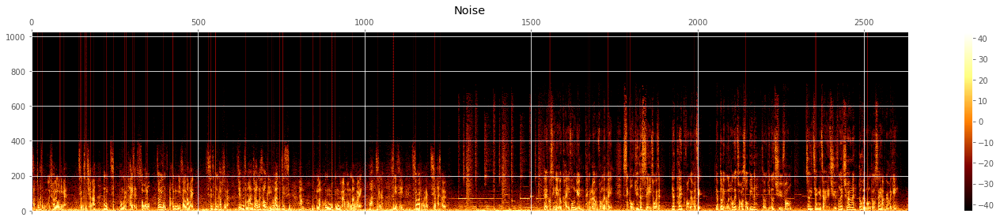

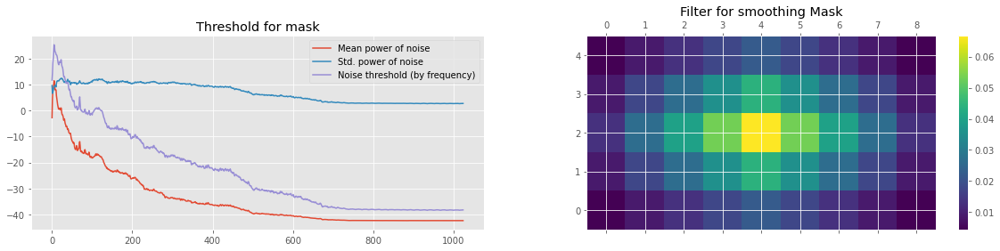

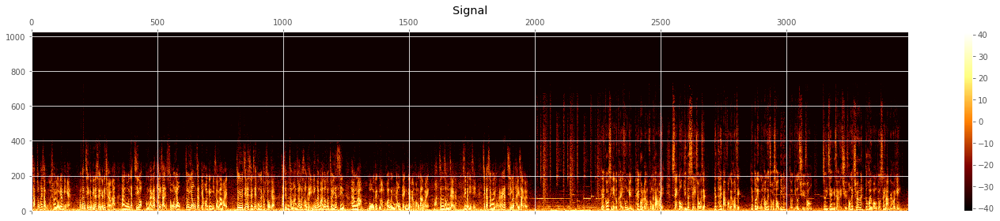

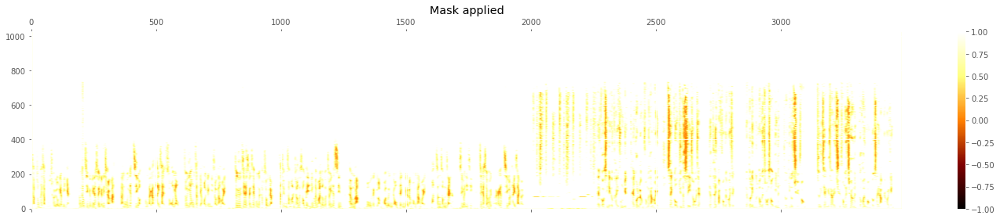

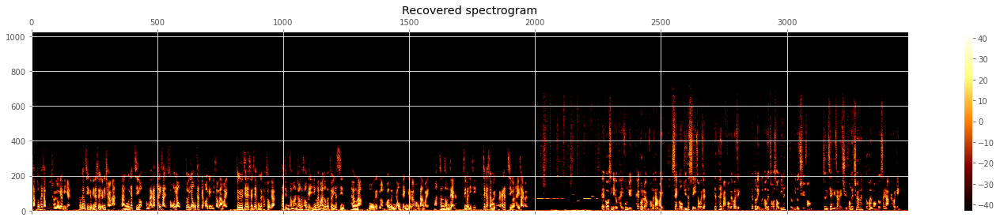

In [68]:
mask, env = envelope(y, params.sr, threshold=params.thr)
y_denoise = nr.reduce_noise(audio_clip=y, noise_clip=y[np.logical_not(mask)], verbose=True)


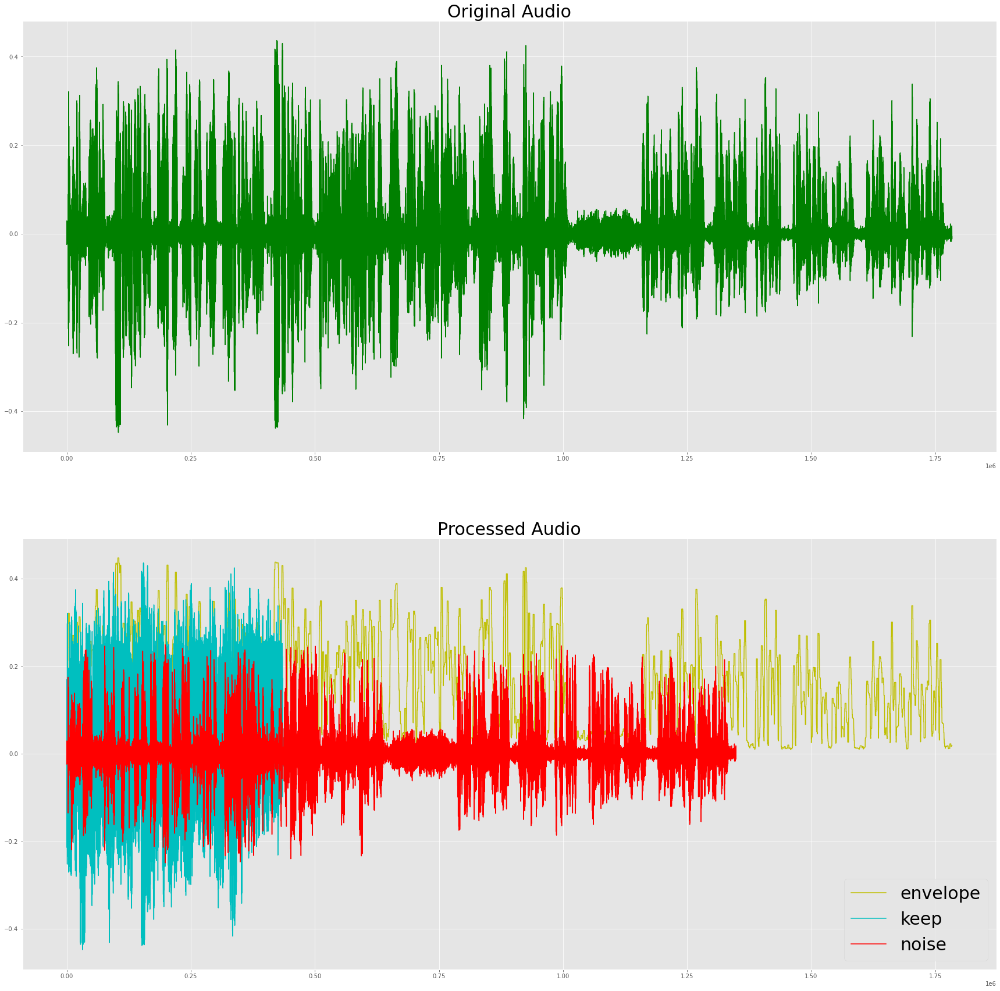

Original Audio


De-noised audio


De-noised audio (Louder)


De-noised audio (Louder + SLOWER)


In [69]:
fig = plt.figure(figsize=(30, 30))
ax1 = fig.add_subplot(211)
ax2 = fig.add_subplot(212)
    
plt.style.use('ggplot')
plt.title('Signal Envelope, Threshold = {}'.format(str(params.thr)))
    
ax1.plot(y, color='g', label='original')
ax1.set_title('Original Audio',fontsize=30)
ax2.plot(env, color='y', label='envelope')
ax2.plot(y[mask], color='c', label='keep')
ax2.plot(y[np.logical_not(mask)], color='r', label='noise')
ax2.legend(loc='best',fontsize=30)
ax2.set_title('Processed Audio',fontsize=30)
plt.show()


print("Original Audio")
display(IPython.display.Audio(y, rate=params.sr))

# print("Noise- Red")
# display(IPython.display.Audio(y[np.logical_not(mask)], rate=params.sr))

# print("Human voice - Blue")
# display(IPython.display.Audio(y[mask], rate=params.sr))

print("De-noised audio")
display(IPython.display.Audio(y_denoise, rate=params.sr))

print("De-noised audio (Louder)")
y = load_audio("pr_" + file_name +"_10", params.sr, PROCESSED_AUDIO_LOUD_ROOT)
display(IPython.display.Audio(y, rate=params.sr))

print("De-noised audio (Louder + SLOWER)")
y = load_audio("pr_" + file_name+"_10_s", params.sr, PROCESSED_AUDIO_LOUD_SLOW_ROOT)
display(IPython.display.Audio(y, rate=params.sr))


In [400]:
# Transcription of noisy audio SNRdb 40: Cantonese 4 + Washer Dryer
noisy_file = file_name
print(noisy_file)
transcribe_gcs(NOISY_AUDIO_ROOT, str(noisy_file + '.wav'))

noisy_Cantonese4_SNRdb_40_WasherDryer_1
Waiting for operation to complete...
Transcript: 集中喺石湖翠路一面嘅優質嘅海景單位首期已經開買咗個最一線向南無敵林海永久景嘅兩房單位真心正呀是不是是即刻上去同大家一次過睇曬佢這個先嚟到啟豐園睇下個兩房嘅單位成個屋苑得四座嘅啫一梯百貨嘅開即入到嚟門口嘅左手邊呢就見到廚房最正嘅就係廚房嘅窗呢都可以望到西南嘅海景
Confidence: 0.9374871253967285


In [401]:
# Transcription of de-noised audio SNRdb 40: Cantonese4 + Washer Dryer
processed_file = str('pr_' + file_name)
print(processed_file)
transcribe_gcs(PROCESSED_AUDIO_ROOT, str(processed_file + '.wav'))

pr_noisy_Cantonese4_SNRdb_40_WasherDryer_1
Waiting for operation to complete...
Transcript: 優質嘅單位要去買咗個最無敵手整嘅兩房單位
Confidence: 0.8798473477363586
Transcript: 喺個兩房
Confidence: 0.7837052345275879


In [402]:
# Transcription of de-noised + louder audio SNRdb 40: Cantonese4 + Washer Dryer
processed_LOUD_file = str("pr_"+file_name+"_10")
print(processed_LOUD_file)
transcribe_gcs(PROCESSED_AUDIO_LOUD_ROOT, str(processed_LOUD_file + '.wav'))

pr_noisy_Cantonese4_SNRdb_40_WasherDryer_1_10
Waiting for operation to complete...
Transcript: 翠路一年去買多個最一線向南無敵南海永久景嘅兩房單位正是不是即刻上去
Confidence: 0.9192221164703369
Transcript: 喺個兩房單位啫
Confidence: 0.9227036833763123


In [403]:
# Transcription of de-noised +louder +slower audio SNRdb 40: Cantonese4 + Washer Dryer
processed_LOUD_S_file = str('pr_' + file_name+"_10_s")
print(processed_LOUD_S_file)
transcribe_gcs(PROCESSED_AUDIO_LOUD_SLOW_ROOT, str(processed_LOUD_S_file + '.wav'), 39690)

pr_noisy_Cantonese4_SNRdb_40_WasherDryer_1_10_s
Waiting for operation to complete...
Transcript: 喺11年嘅首期已經去買咗個對一線向南無敵永久景嘅兩房單位是不是即刻上去
Confidence: 0.9305394887924194
Transcript: 這個主題公園一個兩房單位成個阿姐嘅開的手槍
Confidence: 0.8513513803482056


With a louder de-noised audio, we can see a longer sentense are being grabbed in the audio. However, the noisy video seems to perform so much better with the Google speech-to-text API.

#### Let's continue to check audio with the second least noise - SNRdb 30 

In [18]:
# Example
y = load_audio(df_audio["recording_id"][260], params.sr, NOISY_AUDIO_ROOT)
file_name = df_audio["recording_id"][260]
print(file_name)
#IPython.display.Audio(y, rate=params.sr)

noisy_Cantonese4_SNRdb_30_WasherDryer_1


In [19]:
mask, env = envelope(y, params.sr, params.thr)
y_denoise = nr.reduce_noise(audio_clip=y, noise_clip=y[np.logical_not(mask)], verbose=False)


In [21]:
# # 
# fig = plt.figure(figsize=(30, 30))
# ax1 = fig.add_subplot(211)
# ax2 = fig.add_subplot(212)
    
# plt.style.use('ggplot')
# plt.title('Signal Envelope, Threshold = {}'.format(str(params.thr)))
    
# ax1.plot(y, color='g', label='original')
# ax1.set_title('Original Audio',fontsize=30)
# ax2.plot(env, color='y', label='envelope')
# ax2.plot(y[mask], color='c', label='keep')
# ax2.plot(y[np.logical_not(mask)], color='r', label='noise')
# ax2.legend(loc='best',fontsize=30)
# ax2.set_title('Processed Audio',fontsize=30)
# plt.show()

# print("Original Audio")
# display(IPython.display.Audio(y, rate=params.sr))

# print("Noise- Red")
# display(IPython.display.Audio(y[np.logical_not(mask)], rate=params.sr))

# print("Human voice - Blue")
# display(IPython.display.Audio(y[mask], rate=params.sr))

# print("De-noised audio")
# y_denoise_10=y_denoise*0.1
# display(IPython.display.Audio(y_denoise_10, rate=params.sr))

# print("De-noised audio (Louder)")
# y = load_audio("pr_" + file_name +"_10", params.sr, PROCESSED_AUDIO_LOUD_ROOT)
# display(IPython.display.Audio(y, rate=params.sr))

# print("De-noised audio (Louder + SLOWER)")
# y = load_audio("pr_" + file_name+"_10_s", params.sr, PROCESSED_AUDIO_LOUD_SLOW_ROOT)
# display(IPython.display.Audio(y, rate=params.sr))


In [407]:
# Transcription of noisy audio SNRdb 30: Cantonese4 + Washer Dryer
noisy_file = file_name
print(noisy_file)
transcribe_gcs(NOISY_AUDIO_ROOT, str(noisy_file + '.wav'))

noisy_Cantonese4_SNRdb_30_WasherDryer_1
Waiting for operation to complete...
Transcript: 集中喺石湖翠路一面嘅首期已經開買咗個最一線向南無敵林海永久景嘅兩房單位真心正呀是不是即刻上去同大家一次過睇曬佢這個先嚟到啟豐園睇下個兩房嘅單位成個屋苑得四座嘅啫一梯八婆嘅開即入到嚟門口嘅左手邊呢就見到廚房最正嘅就係廚房嘅窗呢都可以望到西南嘅海景
Confidence: 0.9400666356086731


In [408]:
# Transcription of de-noised audio SNRdb 30: Cantonese4 + Washer Dryer
processed_file = str('pr_' + file_name)
print(processed_file)
transcribe_gcs(PROCESSED_AUDIO_ROOT, str(processed_file + '.wav'))

pr_noisy_Cantonese4_SNRdb_30_WasherDryer_1
Waiting for operation to complete...
Transcript: 優質單位要去買咗個最無敵永久景嘅兩房單位
Confidence: 0.9054800868034363
Transcript: 喺個兩房
Confidence: 0.8847856521606445


In [409]:
# Transcription of de-noised + louder audio SNRdb 30: Cantonese4 + Washer Dryer
processed_LOUD_file = str('pr_' + file_name+"_10")
print(processed_LOUD_file)
transcribe_gcs(PROCESSED_AUDIO_LOUD_ROOT, str(processed_LOUD_file + '.wav'))

pr_noisy_Cantonese4_SNRdb_30_WasherDryer_1_10
Waiting for operation to complete...
Transcript: 翠路一年要去買多個最一線向南無敵南海永久景嘅兩房單位是不是即刻上去一次過睇曬佢
Confidence: 0.9282902479171753
Transcript: 喺個兩房單位啫
Confidence: 0.8937432169914246


In [410]:
# Transcription of de-noised +louder +slower audio SNRdb 30: Cantonese4 + Washer Dryer
processed_LOUD_S_file = str('pr_' + file_name+"_10_s")
print(processed_LOUD_S_file)
transcribe_gcs(PROCESSED_AUDIO_LOUD_SLOW_ROOT, str(processed_LOUD_S_file + '.wav'), 39690)

pr_noisy_Cantonese4_SNRdb_30_WasherDryer_1_10_s
Waiting for operation to complete...
Transcript: 喺11年嘅十萬首期已經去買咗個對一線向南無敵永久景嘅兩房單位是不是即刻上去
Confidence: 0.9358424544334412
Transcript: 這個主題公園喺個兩房單位成個屋苑得四座嘅啫一齊八婆嘅開的手槍
Confidence: 0.9381747245788574


#### Continue to check audio with the next level of noise - SNRdb 20 

In [22]:
# Example
y = load_audio(df_audio["recording_id"][25], params.sr, NOISY_AUDIO_ROOT)
file_name = df_audio["recording_id"][25]
print(file_name)
# IPython.display.Audio(y, rate=params.sr)

noisy_Cantonese4_SNRdb_20_WasherDryer_1


In [21]:
mask, env = envelope(y, params.sr, threshold=params.thr)
y_denoise = nr.reduce_noise(audio_clip=y, noise_clip=y[np.logical_not(mask)], verbose=False)


In [23]:
# print("Original Audio")
# display(IPython.display.Audio(y, rate=params.sr))

# print("Noise- Red")
# display(IPython.display.Audio(y[np.logical_not(mask)], rate=params.sr))

# print("Human voice - Blue")
# display(IPython.display.Audio(y[mask], rate=params.sr))

# print("De-noised audio")
# display(IPython.display.Audio(y_denoise, rate=params.sr))

# print("De-noised audio (Louder)")
# y = load_audio("pr_" + file_name+"_10", params.sr, PROCESSED_AUDIO_LOUD_ROOT)
# display(IPython.display.Audio(y, rate=params.sr))

# print("De-noised audio (Louder + SLOWER)")
# y = load_audio("pr_" + file_name+"_10_s", params.sr, PROCESSED_AUDIO_LOUD_SLOW_ROOT)
# display(IPython.display.Audio(y, rate=params.sr))


In [414]:
# Transcription of noisy audio SNRdb 20: Cantonese4 + Washer Dryer
noisy_file = file_name
print(noisy_file)
transcribe_gcs(NOISY_AUDIO_ROOT, str(noisy_file + '.wav'))

noisy_Cantonese4_SNRdb_20_WasherDryer_1
Waiting for operation to complete...
Transcript: 湖翠路一定贏咗個首期已經開買咗個最一線向南無敵林海永久景嘅兩房單位真心正呀是不是即刻上去同大家一次過睇曬佢這個先嚟到啟豐園睇下個兩房嘅單位成個屋苑得四座嘅啫一梯8火嘅開即入到嚟門口嘅左手邊呢就見到廚房最正嘅就係廚房嘅窗呢都可以望到西南嘅海景
Confidence: 0.9340375661849976


In [415]:
# Transcription of de-noised audio SNRdb 20: Cantonese4 + Washer Dryer
processed_file = str('pr_' + file_name)
print(processed_file)
transcribe_gcs(PROCESSED_AUDIO_ROOT, str(processed_file + '.wav'))

pr_noisy_Cantonese4_SNRdb_20_WasherDryer_1
Waiting for operation to complete...
Transcript: 優質嘅單位要去買咗個最無敵永久景嘅兩房單位
Confidence: 0.8834739327430725
Transcript: 喺個兩房
Confidence: 0.8935620188713074


In [416]:
# Transcription of de-noised + louder audio SNRdb 20: Cantonese4 + Washer Dryer
processed_LOUD_file = str('pr_' + file_name+"_10")
print(processed_LOUD_file)
transcribe_gcs(PROCESSED_AUDIO_LOUD_ROOT, str(processed_LOUD_file + '.wav'))

pr_noisy_Cantonese4_SNRdb_20_WasherDryer_1_10
Waiting for operation to complete...
Transcript: 喺度一年要去買多個最一線向南無敵南海永久景嘅兩房單位正是不是即刻上去一次過睇曬佢
Confidence: 0.8969469666481018
Transcript: 喺個兩房單位
Confidence: 0.9483383297920227


In [417]:
# Transcription of de-noised  +louder +slower audio SNRdb 20: Cantonese4 + Washer Dryer
processed_LOUD_S_file = str('pr_' + file_name+"_10_s")
print(processed_LOUD_S_file)
transcribe_gcs(PROCESSED_AUDIO_LOUD_SLOW_ROOT, str(processed_LOUD_S_file + '.wav'),39690)

pr_noisy_Cantonese4_SNRdb_20_WasherDryer_1_10_s
Waiting for operation to complete...
Transcript: 喺11年嘅十萬首期已經去買咗個聚一線向南無敵永久景嘅兩房單位是不是即刻上去
Confidence: 0.9280931353569031
Transcript: 這個主題公園喺個兩房嘅單位成個屋苑得四座嘅啫一梯8個嘅開的手槍
Confidence: 0.8295170068740845


#### Continue to check audio with the next level of noise - SNRdb 10 

In [24]:
# Example
y = load_audio(df_audio["recording_id"][75], params.sr, NOISY_AUDIO_ROOT)
file_name = df_audio["recording_id"][75]
print(file_name)
# IPython.display.Audio(y, rate=params.sr)

noisy_Cantonese4_SNRdb_10_WasherDryer_1


In [24]:
mask, env = envelope(y, params.sr, params.thr)
y_denoise = nr.reduce_noise(audio_clip=y, noise_clip=y[np.logical_not(mask)], verbose=False)


In [25]:


# print("Original Audio")
# display(IPython.display.Audio(y, rate=params.sr))

# print("Noise- Red")
# display(IPython.display.Audio(y[np.logical_not(mask)], rate=params.sr))

# print("Human voice - Blue")
# display(IPython.display.Audio(y[mask], rate=params.sr))

# print("De-noised audio")
# display(IPython.display.Audio(y_denoise, rate=params.sr))

# print("De-noised audio (Louder)")
# y = load_audio("pr_" + file_name+"_10", params.sr, PROCESSED_AUDIO_LOUD_ROOT)
# display(IPython.display.Audio(y, rate=params.sr))

# print("De-noised audio (Louder + SLOWER)")
# y = load_audio("pr_" + file_name+"_10_s", params.sr, PROCESSED_AUDIO_LOUD_SLOW_ROOT)
# display(IPython.display.Audio(y, rate=params.sr))


In [421]:
# Transcription of noisy audio SNRdb 10: Cantonese4 + Washer Dryer
noisy_file = file_name
print(noisy_file)
transcribe_gcs(NOISY_AUDIO_ROOT, str(noisy_file + '.wav'))

noisy_Cantonese4_SNRdb_10_WasherDryer_1
Waiting for operation to complete...
Transcript: 湖翠路一邊形嘅海景單位首期已經開買咗個最一線向南無敵林海永久景嘅兩房單位真心正呀是不是即刻上去同大家一次過睇曬佢這個星期都啟豐園睇一個兩房單位成個屋苑得四座嘅啫一梯8火嘅開即入到嚟門口嘅左手邊呢就見到廚房最正嘅就係廚房嘅窗呢都可以望到西南嘅海景
Confidence: 0.9447879195213318


In [422]:
# Transcription of de-noised audio SNRdb 10: Cantonese4 + Washer Dryer
processed_file = str('pr_' + file_name)
print(processed_file)
transcribe_gcs(PROCESSED_AUDIO_ROOT, str(processed_file + '.wav'))

pr_noisy_Cantonese4_SNRdb_10_WasherDryer_1
Waiting for operation to complete...
Transcript: 買咗舊景嘅兩房單位
Confidence: 0.8782684803009033


In [423]:
# Transcription of de-noised + louder audio SNRdb 40: Cantonese4 + Washer Dryer
processed_LOUD_file = str('pr_' + file_name+"_10")
print(processed_LOUD_file)
transcribe_gcs(PROCESSED_AUDIO_LOUD_ROOT, str(processed_LOUD_file + '.wav'))

pr_noisy_Cantonese4_SNRdb_10_WasherDryer_1_10
Waiting for operation to complete...
Transcript: 喺度一年先去買咗對一向列無敵南海永久景嘅兩房單位是不是即刻上去睇曬佢
Confidence: 0.876427412033081
Transcript: 喺個兩房單位
Confidence: 0.9142004251480103


In [424]:
# Transcription of de-noised + louder + slower audio SNRdb 40: Cantonese4 + Washer Dryer
processed_LOUD_S_file = str('pr_' + file_name+"_10_s")
print(processed_LOUD_S_file)
transcribe_gcs(PROCESSED_AUDIO_LOUD_SLOW_ROOT, str(processed_LOUD_S_file + '.wav'),39690)

pr_noisy_Cantonese4_SNRdb_10_WasherDryer_1_10_s
Waiting for operation to complete...
Transcript: 喺11年嘅十萬首期已經去買咗個最一線向列無敵永久景嘅兩房單位是不是即刻上去
Confidence: 0.931426465511322
Transcript: 沖完個涼房間為成個啫
Confidence: 0.8680053949356079


#### Continue to check with the loudest level of noise - SNRdb 0

In [26]:
# Example
y = load_audio(df_audio["recording_id"][21], params.sr, NOISY_AUDIO_ROOT)
file_name = df_audio["recording_id"][21]
print(file_name)
# IPython.display.Audio(y, rate=params.sr)

noisy_Cantonese4_SNRdb_0_WasherDryer_1


In [27]:
mask, env = envelope(y, params.sr, params.thr)
y_denoise = nr.reduce_noise(audio_clip=y, noise_clip=y[np.logical_not(mask)], verbose=False)


In [27]:
# print("Original Audio")
# display(IPython.display.Audio(y, rate=params.sr))

# print("Noise- Red")
# display(IPython.display.Audio(y[np.logical_not(mask)], rate=params.sr))

# print("Human voice - Blue")
# display(IPython.display.Audio(y[mask], rate=params.sr))

# print("De-noised audio")
# display(IPython.display.Audio(y_denoise, rate=params.sr))

# print("De-noised audio (Louder)")
# y = load_audio("pr_" + file_name+"_10", params.sr, PROCESSED_AUDIO_LOUD_ROOT)
# display(IPython.display.Audio(y, rate=params.sr))

# print("De-noised audio (Louder + SLOWER)")
# y = load_audio("pr_" + file_name+"_10_s", params.sr, PROCESSED_AUDIO_LOUD_SLOW_ROOT)
# display(IPython.display.Audio(y, rate=params.sr))


In [428]:
# Transcription of noisy audio SNRdb 10: Cantonese4 + Washer Dryer
noisy_file = file_name
print(noisy_file)
transcribe_gcs(NOISY_AUDIO_ROOT, str(noisy_file + '.wav'))

noisy_Cantonese4_SNRdb_0_WasherDryer_1
Waiting for operation to complete...
Transcript: 去到一面嘅單位首期應該買咗個最一線向南無敵林海永久景嘅兩房單位真心正呀是不是詞即刻上去同大家一次過睇曬佢這個星期都啟豐園喺個兩房嘅單位成個屋苑得四座嘅啫一梯8火嘅開即入到嚟門口嘅左手邊呢就見到廚房最正嘅就係廚房嘅窗呢都可以望到西南嘅海景
Confidence: 0.9404147267341614


In [429]:
# Transcription of de-noised audio SNRdb 10: Cantonese4 + Washer Dryer
processed_file = str('pr_' + file_name)
print(processed_file)
transcribe_gcs(PROCESSED_AUDIO_ROOT, str(processed_file + '.wav'))

pr_noisy_Cantonese4_SNRdb_0_WasherDryer_1
Waiting for operation to complete...
Transcript: 香辣單位
Confidence: 0.8014312982559204


In [430]:
# Transcription of de-noised + louder audio SNRdb 10: Cantonese4 + Washer Dryer
processed_LOUD_file = str('pr_' + file_name+"_10")
print(processed_LOUD_file)
transcribe_gcs(PROCESSED_AUDIO_LOUD_ROOT, str(processed_LOUD_file + '.wav'))

pr_noisy_Cantonese4_SNRdb_0_WasherDryer_1_10
Waiting for operation to complete...
Transcript: 買咗香辣永久景嘅單位
Confidence: 0.879761815071106


In [431]:
# Transcription of de-noised + louder + slower audio SNRdb 10: Cantonese4 + Washer Dryer
processed_LOUD_S_file = str('pr_' + file_name+"_10_s")
print(processed_LOUD_S_file)
transcribe_gcs(PROCESSED_AUDIO_LOUD_SLOW_ROOT, str(processed_LOUD_S_file + '.wav'),39690)

pr_noisy_Cantonese4_SNRdb_0_WasherDryer_1_10_s
Waiting for operation to complete...
Transcript: 首先去買到個記一次向列嘅單位
Confidence: 0.8152536749839783
Transcript: 穴位
Confidence: 0.8231258988380432


Seems the de-noising algorithm works washing dryer noise no matter how loud is the noise. Let's try with another stationary noise. 

### Example 2  - Try another stationary noise (air-conditioner)

In [284]:
# find audios index with same clean audio and noise audio 
print("SNRdb_40: " ,  df_audio.loc[df_audio["recording_id"]=='noisy_Cantonese1_SNRdb_40_AirConditioner_1'].index)
print("SNRdb_30: " ,df_audio.loc[df_audio["recording_id"]=='noisy_Cantonese1_SNRdb_30_AirConditioner_1'].index)
print("SNRdb_20: " , df_audio.loc[df_audio["recording_id"]=='noisy_Cantonese1_SNRdb_20_AirConditioner_1'].index)
print("SNRdb_10: " , df_audio.loc[df_audio["recording_id"]=='noisy_Cantonese1_SNRdb_10_AirConditioner_1'].index)
print("SNRdb_0: " ,df_audio.loc[df_audio["recording_id"]=='noisy_Cantonese1_SNRdb_0_AirConditioner_1'].index)

SNRdb_40:  Int64Index([125], dtype='int64')
SNRdb_30:  Int64Index([149], dtype='int64')
SNRdb_20:  Int64Index([28], dtype='int64')
SNRdb_10:  Int64Index([190], dtype='int64')
SNRdb_0:  Int64Index([135], dtype='int64')


In [285]:
# Transcription of clean audio: Cantonese3
transcribe_gcs(CLEAN_AUDIO_ROOT, str('Cantonese1' + '.wav'))

Waiting for operation to complete...
Transcript: 咁南邊件衫保暖水呀嚟緊20年都係咁旺嘅真係20年啦最旺在哪邊件衫出面所有呢個叫天然上街嘅風水格局咁係邊一區有山北邊右邊個反對佢哋嚟講呢度就係南邊一邊就有水水在北京水立研究南邊都太平山呢度呢就係南邊件衫所以記住南邊件衫不變水啦
Confidence: 0.9350771903991699


#### Start with the audio with the least noise - SNRdb 40 

In [29]:
# Example
y = load_audio(df_audio["recording_id"][125], params.sr, NOISY_AUDIO_ROOT)
file_name = df_audio["recording_id"][125]
print(file_name)
# IPython.display.Audio(y, rate=params.sr)

noisy_Cantonese1_SNRdb_40_AirConditioner_1


In [30]:
mask, env = envelope(y, params.sr, threshold=params.thr)
y_denoise = nr.reduce_noise(audio_clip=y, noise_clip=y[np.logical_not(mask)], verbose=False)


In [28]:
# fig = plt.figure(figsize=(30, 30))
# ax1 = fig.add_subplot(211)
# ax2 = fig.add_subplot(212)
    
# plt.style.use('ggplot')
# plt.title('Signal Envelope, Threshold = {}'.format(str(params.thr)))
    
# ax1.plot(y, color='g', label='original')
# ax1.set_title('Original Audio',fontsize=30)
# ax2.plot(env, color='y', label='envelope')
# ax2.plot(y[mask], color='c', label='keep')
# ax2.plot(y[np.logical_not(mask)], color='r', label='noise')
# ax2.legend(loc='best',fontsize=30)
# ax2.set_title('Processed Audio',fontsize=30)
# plt.show()

# print("Original Audio")
# display(IPython.display.Audio(y, rate=params.sr))

# print("Noise- Red")
# display(IPython.display.Audio(y[np.logical_not(mask)], rate=params.sr))

# print("Human voice - Blue")
# display(IPython.display.Audio(y[mask], rate=params.sr))

# print("De-noised audio")
# display(IPython.display.Audio(y_denoise, rate=params.sr))

# print("De-noised audio (Louder)")
# y = load_audio("pr_" + file_name+"_10", params.sr, PROCESSED_AUDIO_LOUD_ROOT)
# display(IPython.display.Audio(y, rate=params.sr))

# print("De-noised audio (Louder + SLOWER)")
# y = load_audio("pr_" + file_name+"_10_s", params.sr, PROCESSED_AUDIO_LOUD_SLOW_ROOT)
# display(IPython.display.Audio(y, rate=params.sr))


In [289]:
# Transcription of noisy audio SNRdb 40: Cantonese1 + Washer Dryer
noisy_file = file_name
print(noisy_file)
transcribe_gcs(NOISY_AUDIO_ROOT, str(noisy_file + '.wav'))

noisy_Cantonese1_SNRdb_40_AirConditioner_1
Waiting for operation to complete...
Transcript: 甘藍邊件衫保暖水呀嚟緊20年都係咁旺嘅真係20年啦最旺係男醫生對面上有呢個叫天然上街嘅風水格局有山北邊右邊個反對佢哋嚟講呢度就係南邊就有水水在北京水立南邊度太平山嗰度呢就係南邊件衫所以記住南邊件衫不變水呢就我
Confidence: 0.935556948184967


In [290]:
# Transcription of de-noised audio SNRdb 40: Cantonese1 + Washer Dryer
processed_file = str('pr_' + file_name)
print(processed_file)
transcribe_gcs(PROCESSED_AUDIO_ROOT, str(processed_file + '.wav'))

pr_noisy_Cantonese1_SNRdb_40_AirConditioner_1
Waiting for operation to complete...
Transcript: 邊件衫嗰啲水呀嚟緊25都係真係20元兌換香港灣仔灣仔點解會喺灣仔邊度睇唔生存
Confidence: 0.9203983545303345


In [291]:
# Transcription of de-noised + louder audio SNRdb 40: Cantonese1 + Washer Dryer
processed_LOUD_file = str('pr_' + file_name+"_10")
print(processed_LOUD_file)
transcribe_gcs(PROCESSED_AUDIO_LOUD_ROOT, str(processed_LOUD_file + '.wav'))

pr_noisy_Cantonese1_SNRdb_40_AirConditioner_1_10
Waiting for operation to complete...
Transcript: 邊件衫搞掂佢呀嚟緊20都係即係20年最旺區香港灣仔灣仔點解會喺灣仔中環去灣仔唔生存
Confidence: 0.9223092794418335


In [292]:
# Transcription of de-noised + louder + slower audio SNRdb 40: Cantonese1 + Washer Dryer
processed_LOUD_S_file = str('pr_' + file_name+"_10_s")
print(processed_LOUD_S_file)
transcribe_gcs(PROCESSED_AUDIO_LOUD_SLOW_ROOT, str(processed_LOUD_S_file + '.wav'),39690)

pr_noisy_Cantonese1_SNRdb_40_AirConditioner_1_10_s
Waiting for operation to complete...
Transcript: 南邊件衫嗰啲暖水呀嚟緊20年都係咁即係20年最旺區香港約大嘅點解會去灣仔呢處
Confidence: 0.9068804383277893


#### Let's continue to check audio with the second least noise - SNRdb 30 

In [30]:
# Example
y = load_audio(df_audio["recording_id"][149], params.sr, NOISY_AUDIO_ROOT)
file_name = df_audio["recording_id"][149]
print(file_name)
# IPython.display.Audio(y, rate=params.sr)

noisy_Cantonese1_SNRdb_30_AirConditioner_1


In [33]:
mask, env = envelope(y, params.sr, threshold= params.thr)
y_denoise = nr.reduce_noise(audio_clip=y, noise_clip=y[np.logical_not(mask)], verbose=False)


In [31]:
# print("Original Audio")
# display(IPython.display.Audio(y, rate=params.sr))

# print("Noise- Red")
# display(IPython.display.Audio(y[np.logical_not(mask)], rate=params.sr))

# print("Human voice - Blue")
# display(IPython.display.Audio(y[mask], rate=params.sr))

# print("De-noised audio")
# display(IPython.display.Audio(y_denoise, rate=params.sr))

# print("De-noised audio (Louder)")
# y = load_audio("pr_" + file_name+"_10", params.sr, PROCESSED_AUDIO_LOUD_ROOT)
# display(IPython.display.Audio(y, rate=params.sr))

# print("De-noised audio (Louder + SLOWER)")
# y = load_audio("pr_" + file_name+"_10_s", params.sr, PROCESSED_AUDIO_LOUD_SLOW_ROOT)
# display(IPython.display.Audio(y, rate=params.sr))


In [296]:
# Transcription of noisy audio SNRdb 30: Cantonese1 + Washer Dryer
noisy_file = file_name
print(noisy_file)
transcribe_gcs(NOISY_AUDIO_ROOT, str(noisy_file + '.wav'))

noisy_Cantonese1_SNRdb_30_AirConditioner_1
Waiting for operation to complete...
Transcript: 咁南邊件衫保暖水呀嚟緊20年都係咁旺嘅真係20年啦最旺在蘭嶼山北面水阿姐呢個叫天然上街嘅風水格局有山有水有邊個返對佢哋嚟講呢度就係南邊一邊就有水水在北京水立南邊都太平山呢度呢就係南邊件衫所以記住南邊件衫不變水呀
Confidence: 0.9438691735267639


In [297]:
# Transcription of de-noised audio SNRdb 30: Cantonese1 + Washer Dryer
processed_file = str('pr_' + file_name)
print(processed_file)
transcribe_gcs(PROCESSED_AUDIO_ROOT, str(processed_file + '.wav'))

pr_noisy_Cantonese1_SNRdb_30_AirConditioner_1
Waiting for operation to complete...
Transcript: 嚟緊25都係真係20元兌換香港灣仔灣仔點解會喺灣仔中環傳
Confidence: 0.9244491457939148


In [298]:
# Transcription of de-noised + louder  audio SNRdb 30: Cantonese1 + Washer Dryer
processed_LOUD_file = str('pr_' + file_name+"_10")
print(processed_LOUD_file)
transcribe_gcs(PROCESSED_AUDIO_LOUD_ROOT, str(processed_LOUD_file + '.wav'))

pr_noisy_Cantonese1_SNRdb_30_AirConditioner_1_10
Waiting for operation to complete...
Transcript: 邊件衫去呀嚟緊20都係即係20年最旺區香港灣仔灣仔點解會喺灣仔中環傳
Confidence: 0.9128967523574829


In [299]:
# Transcription of de-noised + louder + slower audio SNRdb 30: Cantonese1 + Washer Dryer
processed_LOUD_S_file = str('pr_' + file_name+"_10_s")
print(processed_LOUD_S_file)
transcribe_gcs(PROCESSED_AUDIO_LOUD_SLOW_ROOT, str(processed_LOUD_S_file + '.wav'),39690)

pr_noisy_Cantonese1_SNRdb_30_AirConditioner_1_10_s
Waiting for operation to complete...
Transcript: 南邊件衫嗰啲暖水呀嚟緊20年都係咁即係20年最旺係邊一區香港約大嘅點解會去灣仔勞工處
Confidence: 0.9141885638237


#### Continue to check audio with the next level of noise - SNRdb 20 

In [32]:
# Example
y = load_audio(df_audio["recording_id"][28], params.sr, NOISY_AUDIO_ROOT)
file_name = df_audio["recording_id"][28]
print(file_name)
# IPython.display.Audio(y, rate=params.sr)

noisy_Cantonese1_SNRdb_20_AirConditioner_1


In [36]:
mask, env = envelope(y, params.sr, threshold=params.thr)
y_denoise = nr.reduce_noise(audio_clip=y, noise_clip=y[np.logical_not(mask)], verbose=False)


In [33]:
# print("Original Audio")
# display(IPython.display.Audio(y, rate=params.sr))

# print("Noise- Red")
# display(IPython.display.Audio(y[np.logical_not(mask)], rate=params.sr))

# print("Human voice - Blue")
# display(IPython.display.Audio(y[mask], rate=params.sr))

# print("De-noised audio")
# display(IPython.display.Audio(y_denoise, rate=params.sr))

# print("De-noised audio (Louder)")
# y = load_audio("pr_" + file_name+"_10", params.sr, PROCESSED_AUDIO_LOUD_ROOT)
# display(IPython.display.Audio(y, rate=params.sr))

# print("De-noised audio (Louder + SLOWER)")
# y = load_audio("pr_" + file_name+"_10_s", params.sr, PROCESSED_AUDIO_LOUD_SLOW_ROOT)
# display(IPython.display.Audio(y, rate=params.sr))


In [303]:
# Transcription of noisy audio SNRdb 40: Cantonese 3 + Washer Dryer
noisy_file = file_name
print(noisy_file)
transcribe_gcs(NOISY_AUDIO_ROOT, str(noisy_file + '.wav'))

noisy_Cantonese1_SNRdb_20_AirConditioner_1
Waiting for operation to complete...
Transcript: 咁南邊件衫保暖水呀嚟緊20年都係咁旺嘅真係20年啦最旺係男醫生不變所有呢個叫天然上街嘅風水格局郵山北邊右邊個反對佢哋嚟講呢度就係南邊一邊就有水水在北京水立南邊都太平山嗰度呢就係南邊件衫所以記住南邊件衫不變水呢就我
Confidence: 0.9375658631324768


In [304]:
# Transcription of de-noised audio SNRdb 40: Cantonese3 + Washer Dryer
processed_file = str('pr_' + file_name)
print(processed_file)
transcribe_gcs(PROCESSED_AUDIO_ROOT, str(processed_file + '.wav'))

pr_noisy_Cantonese1_SNRdb_20_AirConditioner_1
Waiting for operation to complete...
Transcript: 南邊件衫搞掂佢呀嚟緊25都係真係20年最旺角天台灣仔灣仔點解會喺灣仔邊度睇唔生存
Confidence: 0.8649013638496399


In [305]:
# Transcription of de-noised + louder audio SNRdb 40: Cantonese3 + Washer Dryer
processed_LOUD_file = str('pr_' + file_name+"_10")
print(processed_LOUD_file)
transcribe_gcs(PROCESSED_AUDIO_LOUD_ROOT, str(processed_LOUD_file + '.wav'))

pr_noisy_Cantonese1_SNRdb_20_AirConditioner_1_10
Waiting for operation to complete...
Transcript: 南邊件衫搞掂佢呀嚟緊20都係即係20年最旺區香港灣仔灣仔點解會喺灣仔中環一點解會生存
Confidence: 0.9064851999282837


In [306]:
# Transcription of de-noised + louder + slower audio SNRdb 40: Cantonese3 + Washer Dryer
processed_LOUD_S_file = str('pr_' + file_name+"_10_s")
print(processed_LOUD_S_file)
transcribe_gcs(PROCESSED_AUDIO_LOUD_SLOW_ROOT, str(processed_LOUD_S_file + '.wav'),39690)

pr_noisy_Cantonese1_SNRdb_20_AirConditioner_1_10_s
Waiting for operation to complete...
Transcript: 南邊件衫保暖水呀嚟緊20年都係咁即係20年最旺區香港一大嘅點解會去灣仔呢處
Confidence: 0.9172362685203552


#### Continue to check audio with the next level of noise - SNRdb 10 

In [35]:
# Example
y = load_audio(df_audio["recording_id"][190], params.sr, NOISY_AUDIO_ROOT)
file_name = df_audio["recording_id"][190]
print(file_name)
# IPython.display.Audio(y, rate=params.sr)

noisy_Cantonese1_SNRdb_10_AirConditioner_1


In [308]:
mask, env = envelope(y, params.sr, threshold=params.thr)
y_denoise = nr.reduce_noise(audio_clip=y, noise_clip=y[np.logical_not(mask)], verbose=False)


In [34]:
# print("Original Audio")
# display(IPython.display.Audio(y, rate=params.sr))

# print("Noise- Red")
# display(IPython.display.Audio(y[np.logical_not(mask)], rate=params.sr))

# print("Human voice - Blue")
# display(IPython.display.Audio(y[mask], rate=params.sr))

# print("De-noised audio")
# display(IPython.display.Audio(y_denoise, rate=params.sr))

# print("De-noised audio (Louder)")
# y = load_audio("pr_" + file_name+"_10", params.sr, PROCESSED_AUDIO_LOUD_ROOT)
# display(IPython.display.Audio(y, rate=params.sr))

# print("De-noised audio (Louder + SLOWER)")
# y = load_audio("pr_" + file_name+"_10_s", params.sr, PROCESSED_AUDIO_LOUD_SLOW_ROOT)
# display(IPython.display.Audio(y, rate=params.sr))


In [310]:
# Transcription of noisy audio SNRdb 10: Cantonese 1 + air conditioning
noisy_file = file_name
print(noisy_file)
transcribe_gcs(NOISY_AUDIO_ROOT, str(noisy_file + '.wav'))

noisy_Cantonese1_SNRdb_10_AirConditioner_1
Waiting for operation to complete...
Transcript: 咁南邊件衫分辨水呀嚟緊20年都係咁旺嘅真係20年啦最旺最南邊件衫喺面上架車呢個叫天然上街嘅風水格局咁係邊一區呢邊右邊個反對佢哋嚟講呢度就係南邊一邊度游水所以對我嚟講就係北京水立研究男邊都太平山呢度呢就係南邊見他所以記住南邊件衫不變水啦
Confidence: 0.9324242472648621


In [311]:
# Transcription of de-noised audio SNRdb 10: Cantonese 1 + air conditioning
processed_file = str('pr_' + file_name)
print(processed_file)
transcribe_gcs(PROCESSED_AUDIO_ROOT, str(processed_file + '.wav'))

pr_noisy_Cantonese1_SNRdb_10_AirConditioner_1
Waiting for operation to complete...
Transcript: 邊件衫過嚟緊20都係咁即係20年最旺角街市天台灣仔灣仔點解會喺灣仔中環一點解寄存
Confidence: 0.8857359290122986


In [312]:
# Transcription of de-noised + louder  audio SNRdb 10: Cantonese 1 + air conditioning
processed_LOUD_file = str('pr_' + file_name+"_10")
print(processed_LOUD_file)
transcribe_gcs(PROCESSED_AUDIO_LOUD_ROOT, str(processed_LOUD_file + '.wav'))

pr_noisy_Cantonese1_SNRdb_10_AirConditioner_1_10
Waiting for operation to complete...
Transcript: 邊件衫呢嚟緊20都係即係20年最旺區香港灣仔灣仔點解會喺灣仔中環一大嘅點解會寄存
Confidence: 0.8952039480209351


In [313]:
# Transcription of de-noised + louder + slower audio SNRdb 10: Cantonese 1 + air conditioning
processed_LOUD_S_file = str('pr_' + file_name+"_10_s")
print(processed_LOUD_S_file)
transcribe_gcs(PROCESSED_AUDIO_LOUD_SLOW_ROOT, str(processed_LOUD_S_file + '.wav'),39690)

pr_noisy_Cantonese1_SNRdb_10_AirConditioner_1_10_s
Waiting for operation to complete...
Transcript: 南邊件衫嗰啲暖水呀嚟緊都係咁即係20年最旺區香港中環約大嘅點解會咁威水灣仔嚟記住
Confidence: 0.9235795736312866


#### Continue to check with the loudest level of noise - SNRdb 0

In [36]:
# Example
y = load_audio(df_audio["recording_id"][135], params.sr, NOISY_AUDIO_ROOT)
file_name = df_audio["recording_id"][135]
print(file_name)
# IPython.display.Audio(y, rate=params.sr)

noisy_Cantonese1_SNRdb_0_AirConditioner_1


In [37]:
mask, env = envelope(y, params.sr, threshold=params.thr)
y_denoise = nr.reduce_noise(audio_clip=y, noise_clip=y[np.logical_not(mask)], verbose=False)


In [38]:
# print("Original Audio")
# display(IPython.display.Audio(y, rate=params.sr))

# print("Noise- Red")
# display(IPython.display.Audio(y[np.logical_not(mask)], rate=params.sr))

# print("Human voice - Blue")
# display(IPython.display.Audio(y[mask], rate=params.sr))

# print("De-noised audio")
# display(IPython.display.Audio(y_denoise, rate=params.sr))

# print("De-noised audio (Louder)")
# y = load_audio("pr_" + file_name+"_10", params.sr, PROCESSED_AUDIO_LOUD_ROOT)
# display(IPython.display.Audio(y, rate=params.sr))

# print("De-noised audio (Louder + SLOWER)")
# y = load_audio("pr_" + file_name+"_10_s", params.sr, PROCESSED_AUDIO_LOUD_SLOW_ROOT)
# display(IPython.display.Audio(y, rate=params.sr))


In [317]:
# Transcription of noisy audio SNRdb 10: Cantonese1 + Washer Dryer
noisy_file = file_name
print(noisy_file)
transcribe_gcs(NOISY_AUDIO_ROOT, str(noisy_file + '.wav'))

noisy_Cantonese1_SNRdb_0_AirConditioner_1
Waiting for operation to complete...
Transcript: 甘藍邊件衫保暖水呀嚟緊20年都係咁旺嘅真係20年啦最旺最難以分辨水呀呢個叫天然上街嘅風水格局山北邊右邊個反對佢哋嚟講呢就係南邊就有水水在北京水立南邊度太平山嗰度呢就係南邊件衫出嚟記住南邊件衫不變水啦
Confidence: 0.9370045065879822


In [318]:
# Transcription of de-noised audio SNRdb 10: Cantonese1 + Washer Dryer
processed_file = str('pr_' + file_name)
print(processed_file)
transcribe_gcs(PROCESSED_AUDIO_ROOT, str(processed_file + '.wav'))

pr_noisy_Cantonese1_SNRdb_0_AirConditioner_1
Waiting for operation to complete...
Transcript: 佢呀20都係咁即係20年最旺㗎啦香港灣仔灣仔灣仔道灣仔
Confidence: 0.8586523532867432


In [319]:
# Transcription of de-noised + louder audio SNRdb 10: Cantonese1 + Washer Dryer
processed_LOUD_file = str('pr_' + file_name+"_10")
print(processed_LOUD_file)
transcribe_gcs(PROCESSED_AUDIO_LOUD_ROOT, str(processed_LOUD_file + '.wav'))

pr_noisy_Cantonese1_SNRdb_0_AirConditioner_1_10
Waiting for operation to complete...
Transcript: 唔見320都係即係20年啦最旺區香港灣仔灣仔點解會喺灣仔東華大嘅點解
Confidence: 0.9232569336891174


In [320]:
# Transcription of de-noised + louder + slower audio SNRdb 10: Cantonese1 + Washer Dryer
processed_LOUD_S_file = str('pr_' + file_name+"_10_s")
print(processed_LOUD_S_file)
transcribe_gcs(PROCESSED_AUDIO_LOUD_SLOW_ROOT, str(processed_LOUD_S_file + '.wav'),39690)

pr_noisy_Cantonese1_SNRdb_0_AirConditioner_1_10_s
Waiting for operation to complete...
Transcript: 邊件衫過嚟緊20都係咁即係20年最旺區香港大嘅點解會咁威水灣仔嚟記住
Confidence: 0.890719473361969


Just by listening, it seems the de-noising algorithm works well for stationary audio no matter how loud is the noise. Let's try it also with non-stationary audio. 

### Example 3 - Non-stationary noise (Keyboard Typing)

In [433]:
# find audios index with same clean audio and noise audio 
print("SNRdb_40: " ,  df_audio.loc[df_audio["recording_id"]=='noisy_Cantonese3_SNRdb_40_Typing_5'].index)
print("SNRdb_30: " ,df_audio.loc[df_audio["recording_id"]=='noisy_Cantonese3_SNRdb_30_Typing_5'].index)
print("SNRdb_20: " , df_audio.loc[df_audio["recording_id"]=='noisy_Cantonese3_SNRdb_20_Typing_5'].index)
print("SNRdb_10: " , df_audio.loc[df_audio["recording_id"]=='noisy_Cantonese3_SNRdb_10_Typing_5'].index)
print("SNRdb_0: " ,df_audio.loc[df_audio["recording_id"]=='noisy_Cantonese3_SNRdb_0_Typing_5'].index)

SNRdb_40:  Int64Index([158], dtype='int64')
SNRdb_30:  Int64Index([201], dtype='int64')
SNRdb_20:  Int64Index([109], dtype='int64')
SNRdb_10:  Int64Index([129], dtype='int64')
SNRdb_0:  Int64Index([111], dtype='int64')


In [434]:
# Transcription of clean audio: Cantonese3
transcribe_gcs(CLEAN_AUDIO_ROOT, str('Cantonese3' + '.wav'))

Waiting for operation to complete...
Transcript: 本身係代表係咩呀病呀真係我真係代表佢就病啦嗰啲病聲啦但係都易搵佢幫忙嘅時候呢都係會變才真㗎咁然後呢我哋當你知道咗呢件事㗎有乜好處呀都係做咗九運最旺嘅時候係屬於喺邊呀走成屬於喺南邊嘅上面呀南邊所以男就係最旺區分喺香港見到
Confidence: 0.939588189125061


#### Start with the audio with the least noise - SNRdb 40 

In [39]:
# Example
y = load_audio(df_audio["recording_id"][158], params.sr, NOISY_AUDIO_ROOT)
file_name = df_audio["recording_id"][158]
print(file_name)
# IPython.display.Audio(y, rate=params.sr)

noisy_Cantonese3_SNRdb_40_Typing_5


In [41]:
mask, env = envelope(y, params.sr, threshold=params.thr)
y_denoise = nr.reduce_noise(audio_clip=y, noise_clip=y[np.logical_not(mask)], verbose=False)

In [40]:
# fig = plt.figure(figsize=(30, 30))
# ax1 = fig.add_subplot(211)
# ax2 = fig.add_subplot(212)
    
# plt.style.use('ggplot')
# plt.title('Signal Envelope, Threshold = {}'.format(str(params.thr)))
    
# ax1.plot(y, color='g', label='original')
# ax1.set_title('Original Audio',fontsize=30)
# ax2.plot(env, color='y', label='envelope')
# ax2.plot(y[mask], color='c', label='keep')
# ax2.plot(y[np.logical_not(mask)], color='r', label='noise')
# ax2.legend(loc='best',fontsize=30)
# ax2.set_title('Processed Audio',fontsize=30)
# plt.show()

# print("Original Audio")
# display(IPython.display.Audio(y, rate=params.sr))

# print("Noise- Red")
# display(IPython.display.Audio(y[np.logical_not(mask)], rate=params.sr))

# print("Human voice - Blue")
# display(IPython.display.Audio(y[mask], rate=params.sr))

# print("De-noised audio")
# display(IPython.display.Audio(y_denoise, rate=params.sr))

# print("De-noised audio (Louder)")
# y = load_audio("pr_" + file_name+"_10", params.sr, PROCESSED_AUDIO_LOUD_ROOT)
# display(IPython.display.Audio(y, rate=params.sr))

# print("De-noised audio (Louder + SLOWER)")
# y = load_audio("pr_" + file_name+"_10_s", params.sr, PROCESSED_AUDIO_LOUD_SLOW_ROOT)
# display(IPython.display.Audio(y, rate=params.sr))


In [438]:
# Transcription of noisy audio SNRdb 40: Cantonese3 + Keyboard typing
noisy_file = file_name
print(noisy_file)
transcribe_gcs(NOISY_AUDIO_ROOT, str(noisy_file + '.wav'))

noisy_Cantonese3_SNRdb_40_Typing_5
Waiting for operation to complete...
Transcript: 本身係代表係咩呀病呀真係即係代表佢就病啦嗰啲病聲啦佢幫忙嘅時候呢都係會變才真㗎咁然後呢我哋當你知道咗呢件事㗎有乜好處呀都係做咗九運最旺嘅時候係屬於喺邊呀走成屬於喺南邊嘅上面呀南邊所以男就係最旺嘅喺香港見到乜嘢就要見到
Confidence: 0.9436852335929871


In [439]:
# Transcription of de-noised audio SNRdb 40: Cantonese3 + Keyboard typing
processed_file = str('pr_' + file_name)
print(processed_file)
transcribe_gcs(PROCESSED_AUDIO_ROOT, str(processed_file + '.wav'))

pr_noisy_Cantonese3_SNRdb_40_Typing_5
Waiting for operation to complete...
Transcript: 黃好處呀喺邊呀上面就係最旺香港人喺旺嘅方向
Confidence: 0.9010326862335205


In [440]:
# Transcription of de-noised + louder audio SNRdb 40: Cantonese3 + Keyboard typing
processed_LOUD_file = str('pr_' + file_name+"_10")
print(processed_LOUD_file)
transcribe_gcs(PROCESSED_AUDIO_LOUD_ROOT, str(processed_LOUD_file + '.wav'))

pr_noisy_Cantonese3_SNRdb_40_Typing_5_10
Waiting for operation to complete...
Transcript: 然後呢我哋當你知道咗啲乜好處呀99豬喺邊呀我喺上面呀就係最旺香港人喺旺嘅方向
Confidence: 0.9383516907691956


In [441]:
# Transcription of de-noised + louder + slower audio SNRdb 40: Cantonese3 + Keyboard typing
processed_LOUD_S_file = str('pr_' + file_name+"_10_s")
print(processed_LOUD_S_file)
transcribe_gcs(PROCESSED_AUDIO_LOUD_SLOW_ROOT, str(processed_LOUD_S_file + '.wav'),39690)

pr_noisy_Cantonese3_SNRdb_40_Typing_5_10_s
Waiting for operation to complete...
Transcript: 然後呢我哋幫你有咩好處呀喺邊呀喺上面呀衰男仔係最旺區香港喺旺角方向
Confidence: 0.9128121137619019


#### Let's continue to check audio with the second least noise - SNRdb 30 

In [42]:
# Example
y = load_audio(df_audio["recording_id"][201], params.sr, NOISY_AUDIO_ROOT)
file_name = df_audio["recording_id"][201]
print(file_name)
# IPython.display.Audio(y, rate=params.sr)

noisy_Cantonese3_SNRdb_30_Typing_5


In [47]:
mask, env = envelope(y, params.sr, threshold=params.thr)
y_denoise = nr.reduce_noise(audio_clip=y, noise_clip=y[np.logical_not(mask)], verbose=False)

In [43]:
# print("Original Audio")
# display(IPython.display.Audio(y, rate=params.sr))

# print("Noise- Red")
# display(IPython.display.Audio(y[np.logical_not(mask)], rate=params.sr))

# print("Human voice - Blue")
# display(IPython.display.Audio(y[mask], rate=params.sr))

# print("De-noised audio")
# display(IPython.display.Audio(y_denoise, rate=params.sr))

# print("De-noised audio (Louder)")
# y = load_audio("pr_" + file_name+"_10", params.sr, PROCESSED_AUDIO_LOUD_ROOT)
# display(IPython.display.Audio(y, rate=params.sr))

# print("De-noised audio (Louder + SLOWER)")
# y = load_audio("pr_" + file_name+"_10_s", params.sr, PROCESSED_AUDIO_LOUD_SLOW_ROOT)
# display(IPython.display.Audio(y, rate=params.sr))


In [445]:
# Transcription of noisy audio SNRdb 30: Cantonese3 + Keyboard typing
noisy_file = file_name
print(noisy_file)
transcribe_gcs(NOISY_AUDIO_ROOT, str(noisy_file + '.wav'))

noisy_Cantonese3_SNRdb_30_Typing_5
Waiting for operation to complete...
Transcript: 本身係代表係咩呀病呀真係我真係代表佢就病啦嗰啲病聲啦佢幫忙嘅時候呢都係會變財神㗎咁然後呢我哋當你知道咗呢件事㗎有乜好處呀都係做咗九運最旺嘅時候係屬於喺邊呀走成屬於喺南邊嘅上面呀南邊所以男就係最旺嘅喺香港最好就要見到乜嘢就要見到
Confidence: 0.9399951100349426


In [446]:
# Transcription of de-noised audio SNRdb 30: Cantonese3 + Keyboard typing
processed_file = str('pr_' + file_name)
print(processed_file)
transcribe_gcs(PROCESSED_AUDIO_ROOT, str(processed_file + '.wav'))

pr_noisy_Cantonese3_SNRdb_30_Typing_5
Waiting for operation to complete...
Transcript: 99喺邊邊上面就係最旺香港喺旺嘅方向
Confidence: 0.9185742735862732


In [447]:
# Transcription of de-noised + louder audio SNRdb 30: Cantonese3 + Keyboard typing
processed_LOUD_file = str('pr_' + file_name+"_10")
print(processed_LOUD_file)
transcribe_gcs(PROCESSED_AUDIO_LOUD_ROOT, str(processed_LOUD_file + '.wav'))

pr_noisy_Cantonese3_SNRdb_30_Typing_5_10
Waiting for operation to complete...
Transcript: 然後呢我哋當你知道咗啲乜好處呀99豬喺邊呀我喺上面呀就係最旺香港喺旺嘅方向
Confidence: 0.9145442247390747


In [448]:
# Transcription of de-noised + louder + slower audio SNRdb 30: Cantonese3 + Keyboard typing
processed_LOUD_S_file = str('pr_' + file_name+"_10_s")
print(processed_LOUD_S_file)
transcribe_gcs(PROCESSED_AUDIO_LOUD_SLOW_ROOT, str(processed_LOUD_S_file + '.wav'),39690)

pr_noisy_Cantonese3_SNRdb_30_Typing_5_10_s
Waiting for operation to complete...
Transcript: 然後呢我哋當你有乜好處呢喺邊呀喺上面呀衰男仔係最旺區喺旺角方向
Confidence: 0.9015092849731445


#### Continue to check audio with the next level of noise - SNRdb 20 

In [44]:
# Example
y = load_audio(df_audio["recording_id"][109], params.sr, NOISY_AUDIO_ROOT)
file_name = df_audio["recording_id"][109]
print(file_name)
# IPython.display.Audio(y, rate=params.sr)

noisy_Cantonese3_SNRdb_20_Typing_5


In [50]:
mask, env = envelope(y, params.sr, threshold = params.thr)
y_denoise = nr.reduce_noise(audio_clip=y, noise_clip=y[np.logical_not(mask)], verbose=False)

In [45]:
# print("Original Audio")
# display(IPython.display.Audio(y, rate=params.sr))

# print("Noise- Red")
# display(IPython.display.Audio(y[np.logical_not(mask)], rate=params.sr))

# print("Human voice - Blue")
# display(IPython.display.Audio(y[mask], rate=params.sr))

# print("De-noised audio")
# display(IPython.display.Audio(y_denoise, rate=params.sr))

# print("De-noised audio (Louder)")
# y = load_audio("pr_" + file_name+"_10", params.sr, PROCESSED_AUDIO_LOUD_ROOT)
# display(IPython.display.Audio(y, rate=params.sr))

# print("De-noised audio (Louder + SLOWER)")
# y = load_audio("pr_" + file_name+"_10_s", params.sr, PROCESSED_AUDIO_LOUD_SLOW_ROOT)
# display(IPython.display.Audio(y, rate=params.sr))


In [452]:
# Transcription of noisy audio SNRdb 40: Cantonese 3 + Keyboard typing
noisy_file = file_name
print(noisy_file)
transcribe_gcs(NOISY_AUDIO_ROOT, str(noisy_file + '.wav'))

noisy_Cantonese3_SNRdb_20_Typing_5
Waiting for operation to complete...
Transcript: 本身係代表係咩呀病呀真係我真係代表佢就病啦佢嗰啲病聲啦但係都易搵佢幫忙嘅時候呢都係會變財神㗎咁然後呢我哋當你知道咗呢件事㗎有乜好處呀都係做咗九運最旺嘅時候係屬於喺邊呀走成屬於喺南邊嘅上面呀南邊所以男就係最旺區分喺香港呢最好就要見到乜嘢就要見到有
Confidence: 0.9397298693656921


In [453]:
# Transcription of de-noised audio SNRdb 40: Cantonese 3 + Keyboard typing
processed_file = str('pr_' + file_name)
print(processed_file)
transcribe_gcs(PROCESSED_AUDIO_ROOT, str(processed_file + '.wav'))

pr_noisy_Cantonese3_SNRdb_20_Typing_5
Waiting for operation to complete...
Transcript: 都係朝早九呀喺上面呀係最旺香港喺旺嘅方向
Confidence: 0.9324653148651123


In [454]:
# Transcription of de-noised + louder audio SNRdb 20: Cantonese 3 + Keyboard typing
processed_LOUD_file = str('pr_' + file_name+"_10")
print(processed_LOUD_file)
transcribe_gcs(PROCESSED_AUDIO_LOUD_ROOT, str(processed_LOUD_file + '.wav'))

pr_noisy_Cantonese3_SNRdb_20_Typing_5_10
Waiting for operation to complete...
Transcript: 我哋到咗99喺邊邊點呀就係最旺香港喺旺嘅方向
Confidence: 0.9351200461387634


In [455]:
# Transcription of de-noised + louder + slower audio SNRdb 20: Cantonese 3 + Keyboard typing
processed_LOUD_S_file = str('pr_' + file_name+"_10_s")
print(processed_LOUD_S_file)
transcribe_gcs(PROCESSED_AUDIO_LOUD_SLOW_ROOT, str(processed_LOUD_S_file + '.wav'),39690)

pr_noisy_Cantonese3_SNRdb_20_Typing_5_10_s
Waiting for operation to complete...
Transcript: 然後呢我哋當你喺邊呀喺上面吹男仔最旺區喺旺角方向
Confidence: 0.9167277216911316


#### Continue to check audio with the next level of noise - SNRdb 10 

In [46]:
# Example
y = load_audio(df_audio["recording_id"][129], params.sr, NOISY_AUDIO_ROOT)
file_name = df_audio["recording_id"][129]
print(file_name)
# IPython.display.Audio(y, rate=params.sr)

noisy_Cantonese3_SNRdb_10_Typing_5


In [53]:
mask, env = envelope(y, params.sr, threshold= params.thr)
y_denoise = nr.reduce_noise(audio_clip=y, noise_clip=y[np.logical_not(mask)], verbose=False)


In [47]:
# print("Original Audio")
# display(IPython.display.Audio(y, rate=params.sr))

# print("Noise- Red")
# display(IPython.display.Audio(y[np.logical_not(mask)], rate=params.sr))

# print("Human voice - Blue")
# display(IPython.display.Audio(y[mask], rate=params.sr))

# print("De-noised audio")
# display(IPython.display.Audio(y_denoise, rate=params.sr))

# print("De-noised audio (Louder)")
# y = load_audio("pr_" + file_name+"_10", params.sr, PROCESSED_AUDIO_LOUD_ROOT)
# display(IPython.display.Audio(y, rate=params.sr))

# print("De-noised audio (Louder + SLOWER)")
# y = load_audio("pr_" + file_name+"_10_s", params.sr, PROCESSED_AUDIO_LOUD_SLOW_ROOT)
# display(IPython.display.Audio(y, rate=params.sr))


In [459]:
# Transcription of noisy audio SNRdb 10: Cantonese3 + Keyboard typing
noisy_file = file_name
print(noisy_file)
transcribe_gcs(NOISY_AUDIO_ROOT, str(noisy_file + '.wav'))

noisy_Cantonese3_SNRdb_10_Typing_5
Waiting for operation to complete...
Transcript: 本身係代表係咩呀病呀真係我真係代表佢就病啦嗰啲尿病適當嘅時候呢都係會變財神㗎咁然後呢我哋當你知道咗呢件事㗎有乜好處呀都係少咗九運最旺嘅時候係屬於喺邊一邊呀走成屬於喺南邊嘅上面呀南邊所以男就係最旺區分喺香港呢最好就要見到乜嘢就要見到有
Confidence: 0.93707275390625


In [460]:
# Transcription of de-noised audio SNRdb 10: Cantonese3 + Keyboard typing
processed_file = str('pr_' + file_name)
print(processed_file)
transcribe_gcs(PROCESSED_AUDIO_ROOT, str(processed_file + '.wav'))

pr_noisy_Cantonese3_SNRdb_10_Typing_5
Waiting for operation to complete...
Transcript: 朝早九呀喺邊點呀西蘭最旺香港喺旺嘅方向
Confidence: 0.9109000563621521


In [461]:
# Transcription of de-noised + louder audio SNRdb 10: Cantonese3 + Keyboard typing
processed_LOUD_file = str('pr_' + file_name+"_10")
print(processed_LOUD_file)
transcribe_gcs(PROCESSED_AUDIO_LOUD_ROOT, str(processed_LOUD_file + '.wav'))

pr_noisy_Cantonese3_SNRdb_10_Typing_5_10
Waiting for operation to complete...
Transcript: 我哋到咗九呀喺邊呀點呀西南西北香港喺旺嘅方向
Confidence: 0.879182755947113


In [462]:
# Transcription of de-noised + louder + slower audio SNRdb 10: Cantonese3 + Keyboard typing
processed_LOUD_S_file = str('pr_' + file_name+"_10_s")
print(processed_LOUD_S_file)
transcribe_gcs(PROCESSED_AUDIO_LOUD_SLOW_ROOT, str(processed_LOUD_S_file + '.wav'),39690)

pr_noisy_Cantonese3_SNRdb_10_Typing_5_10_s
Waiting for operation to complete...
Transcript: 喺邊邊吹男仔最旺區喺旺角方向
Confidence: 0.9361069202423096


#### Continue to check with the loudest level of noise - SNRdb 0

In [48]:
# Example
y = load_audio(df_audio["recording_id"][111], params.sr, NOISY_AUDIO_ROOT)
file_name = df_audio["recording_id"][111]
print(file_name)
# IPython.display.Audio(y, rate=params.sr)

noisy_Cantonese3_SNRdb_0_Typing_5


In [56]:
mask, env = envelope(y, params.sr, threshold=params.thr)
y_denoise = nr.reduce_noise(audio_clip=y, noise_clip=y[np.logical_not(mask)], verbose=False)


In [49]:
# print("Original Audio")
# display(IPython.display.Audio(y, rate=params.sr))

# print("Noise- Red")
# display(IPython.display.Audio(y[np.logical_not(mask)], rate=params.sr))

# print("Human voice - Blue")
# display(IPython.display.Audio(y[mask], rate=params.sr))

# print("De-noised audio")
# display(IPython.display.Audio(y_denoise, rate=params.sr))

# print("De-noised audio (Louder)")
# y = load_audio("pr_" + file_name+"_10", params.sr, PROCESSED_AUDIO_LOUD_ROOT)
# display(IPython.display.Audio(y, rate=params.sr))

# print("De-noised audio (Louder + SLOWER)")
# y = load_audio("pr_" + file_name+"_10_s", params.sr, PROCESSED_AUDIO_LOUD_SLOW_ROOT)
# display(IPython.display.Audio(y, rate=params.sr))


In [466]:
# Transcription of noisy audio SNRdb 0: Cantonese3 + Keyboard typing
noisy_file = file_name
print(noisy_file)
transcribe_gcs(NOISY_AUDIO_ROOT, str(noisy_file + '.wav'))

noisy_Cantonese3_SNRdb_0_Typing_5
Waiting for operation to complete...
Transcript: 本身係代表係咩呀病呀真係我真係代表佢就梗啦嗰啲病徵但佢都係會變財神㗎咁然後呢我哋當你知道咗呢件事㗎有乜好處呢都係朝早九運最旺嘅時候係屬於喺邊一邊呀走成屬於喺南邊嘅上面呀南邊所以南就係最旺區分喺香港哪裏面最好就要見到乜嘢就要見到有
Confidence: 0.9361072778701782


In [467]:
# Transcription of de-noised audio SNRdb 0: Cantonese3 + Keyboard typing
processed_file = str('pr_' + file_name)
print(processed_file)
transcribe_gcs(PROCESSED_AUDIO_ROOT, str(processed_file + '.wav'))

pr_noisy_Cantonese3_SNRdb_0_Typing_5
Waiting for operation to complete...
Transcript: 朝早九點呀西蘭香港喺旺嘅方向
Confidence: 0.9159801006317139


In [468]:
# Transcription of de-noised  + louder audio SNRdb 0: Cantonese3 + Keyboard typing
processed_LOUD_file = str('pr_' + file_name+"_10")
print(processed_LOUD_file)
transcribe_gcs(PROCESSED_AUDIO_LOUD_ROOT, str(processed_LOUD_file + '.wav'))

pr_noisy_Cantonese3_SNRdb_0_Typing_5_10
Waiting for operation to complete...
Transcript: 朝早九點呀西蘭嶼王世界香港喺旺嘅方向
Confidence: 0.9301376342773438


In [469]:
# Transcription of de-noised + louder + slower audio SNRdb 0: Cantonese3 + Keyboard typing
processed_LOUD_S_file = str('pr_' + file_name+"_10_s")
print(processed_LOUD_S_file)
transcribe_gcs(PROCESSED_AUDIO_LOUD_SLOW_ROOT, str(processed_LOUD_S_file + '.wav'),39690)

pr_noisy_Cantonese3_SNRdb_0_Typing_5_10_s
Waiting for operation to complete...
Transcript: 追男仔最旺區
Confidence: 0.8706043362617493


The typing noise had been reduced, but for the loudest 2 level, it is still obvious to have the typing noise sometimes. 

### Example 4  - Non-stationary noise (human chatting noise at Restaurant)

In [358]:
# find audios index with same clean audio and noise audio 
print("SNRdb_40: " ,  df_audio.loc[df_audio["recording_id"]=='noisy_Cantonese5_SNRdb_40_Restaurant_1'].index)
print("SNRdb_30: " ,df_audio.loc[df_audio["recording_id"]=='noisy_Cantonese5_SNRdb_30_Restaurant_1'].index)
print("SNRdb_20: " , df_audio.loc[df_audio["recording_id"]=='noisy_Cantonese5_SNRdb_20_Restaurant_1'].index)
print("SNRdb_10: " , df_audio.loc[df_audio["recording_id"]=='noisy_Cantonese5_SNRdb_10_Restaurant_1'].index)
print("SNRdb_0: " ,df_audio.loc[df_audio["recording_id"]=='noisy_Cantonese5_SNRdb_0_Restaurant_1'].index)

SNRdb_40:  Int64Index([191], dtype='int64')
SNRdb_30:  Int64Index([284], dtype='int64')
SNRdb_20:  Int64Index([241], dtype='int64')
SNRdb_10:  Int64Index([206], dtype='int64')
SNRdb_0:  Int64Index([159], dtype='int64')


In [359]:
# Transcription of clean audio: Cantonese3
transcribe_gcs(CLEAN_AUDIO_ROOT, str('Cantonese5' + '.wav'))

Waiting for operation to complete...
Transcript: 邊個第二行呀但係你記住我怕本身係病適唔適當嘅時候呢都係會變才真㗎咁然後呢我哋當你知道咗呢件事㗎有乜好處嘅時候係屬於喺邊一邊呀舊石屬於喺南邊嘅上面呀南邊所以南就係最旺嘅區
Confidence: 0.922203779220581


#### Start with the audio with the least noise - SNRdb 40 

In [50]:
# Example
y = load_audio(df_audio["recording_id"][191], params.sr, NOISY_AUDIO_ROOT)
file_name = df_audio["recording_id"][191]
print(file_name)
# IPython.display.Audio(y, rate=params.sr)

noisy_Cantonese5_SNRdb_40_Restaurant_1


  0%|          | 0/7 [00:00<?, ?it/s]

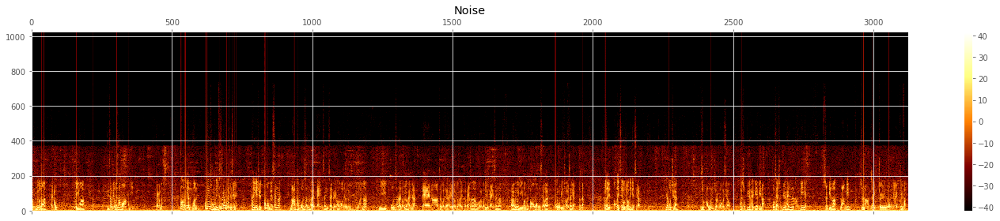

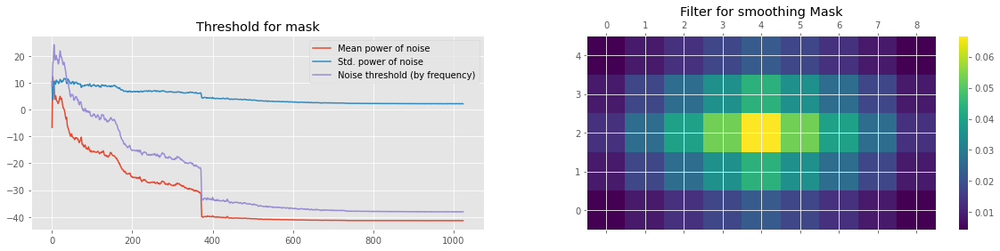

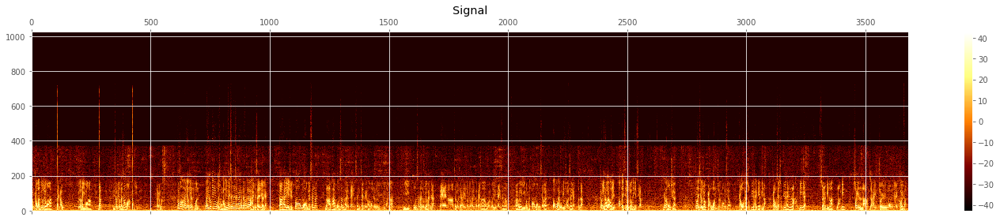

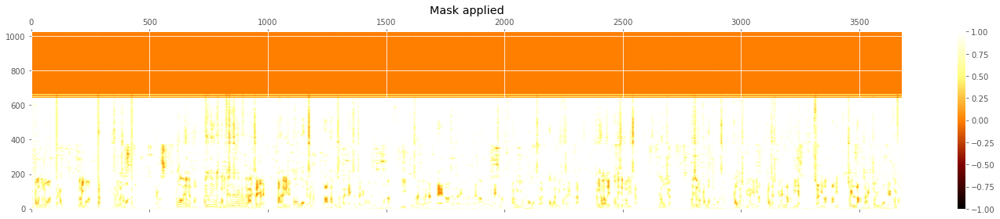

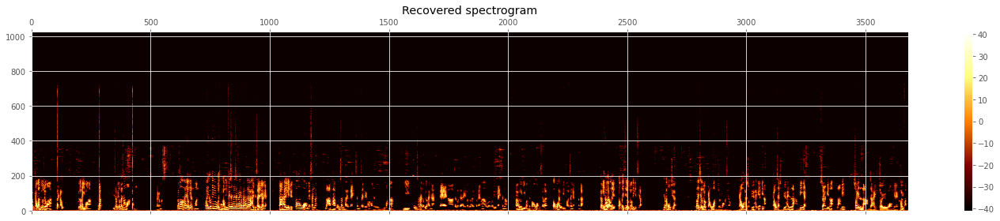

In [59]:
mask, env = envelope(y, params.sr, threshold=params.thr)
y_denoise = nr.reduce_noise(audio_clip=y, noise_clip=y[np.logical_not(mask)], verbose=True)


In [51]:

# mask, env = envelope(y, params.sr, threshold=params.thr)
# fig = plt.figure(figsize=(30, 30))
# ax1 = fig.add_subplot(211)
# ax2 = fig.add_subplot(212)
    
# plt.style.use('ggplot')
# plt.title('Signal Envelope, Threshold = {}'.format(str(params.thr)))
    
# ax1.plot(y, color='g', label='original')
# ax1.set_title('Original Audio',fontsize=30)
# ax2.plot(env, color='y', label='envelope')
# ax2.plot(y[mask], color='c', label='keep')
# ax2.plot(y[np.logical_not(mask)], color='r', label='noise')
# ax2.legend(loc='best',fontsize=30)
# ax2.set_title('Processed Audio',fontsize=30)
# plt.show()

# print("Original Audio")
# display(IPython.display.Audio(y, rate=params.sr))

# print("Noise- Red")
# display(IPython.display.Audio(y[np.logical_not(mask)], rate=params.sr))

# print("Human voice - Blue")
# display(IPython.display.Audio(y[mask], rate=params.sr))

# print("De-noised audio")
# display(IPython.display.Audio(y_denoise, rate=params.sr))

# print("De-noised audio (Louder)")
# y = load_audio("pr_" + file_name+"_10", params.sr, PROCESSED_AUDIO_LOUD_ROOT)
# display(IPython.display.Audio(y, rate=params.sr))

# print("De-noised audio (Louder + SLOWER)")
# y = load_audio("pr_" + file_name+"_10_s", params.sr, PROCESSED_AUDIO_LOUD_SLOW_ROOT)
# display(IPython.display.Audio(y, rate=params.sr))


In [61]:
# Transcription of noisy audio SNRdb 40
noisy_file = file_name
print(noisy_file)
transcribe_gcs(NOISY_AUDIO_ROOT, str(noisy_file + '.wav'))

noisy_Cantonese5_SNRdb_40_Restaurant_1
Waiting for operation to complete...
Transcript: 邊個第二行呀但係你嘅病嘅時候呢都係會變才真㗎咁然後呢我哋當你知道咗呢件事㗎九成屬於喺南邊嘅上面呀南邊所以男就係最旺嘅區
Confidence: 0.938701331615448


In [62]:
# Transcription of de-noised audio SNRdb 40
processed_file = str('pr_' + file_name)
print(processed_file)
transcribe_gcs(PROCESSED_AUDIO_ROOT, str(processed_file + '.wav'))

pr_noisy_Cantonese5_SNRdb_40_Restaurant_1
Waiting for operation to complete...
Transcript: 蛋黃哥和舊城區南大嶼王
Confidence: 0.8176135420799255


In [63]:
# Transcription of de-noised + louder audio SNRdb 40
processed_LOUD_file = str('pr_' + file_name+"_10")
print(processed_LOUD_file)
transcribe_gcs(PROCESSED_AUDIO_LOUD_ROOT, str(processed_LOUD_file + '.wav'))

pr_noisy_Cantonese5_SNRdb_40_Restaurant_1_10
Waiting for operation to complete...
Transcript: 但係阿黃阿黃喺上面呀衰男人就係最旺
Confidence: 0.8943064212799072


In [64]:
# Transcription of de-noised  + louder + slower audio SNRdb 40
processed_LOUD_S_file = str('pr_' + file_name+"_10_s")
print(processed_LOUD_S_file)
transcribe_gcs(PROCESSED_AUDIO_LOUD_SLOW_ROOT, str(processed_LOUD_S_file + '.wav'),39690)


pr_noisy_Cantonese5_SNRdb_40_Restaurant_1_10_s
Waiting for operation to complete...
Transcript: 但係阿黃阿黃都係朝早九呀喺邊喺上面係最旺
Confidence: 0.9344620108604431


#### Let's continue to check audio with the second least noise - SNRdb 30 

In [52]:
# Example
y = load_audio(df_audio["recording_id"][284], params.sr, NOISY_AUDIO_ROOT)
print(df_audio["recording_id"][284])
# IPython.display.Audio(y, rate=params.sr)

noisy_Cantonese5_SNRdb_30_Restaurant_1


In [104]:
mask, env = envelope(y, params.sr, threshold= params.thr)
y_denoise = nr.reduce_noise(audio_clip=y, noise_clip=y[np.logical_not(mask)], verbose=False)


In [53]:
# print("Original Audio")
# display(IPython.display.Audio(y, rate=params.sr))

# print("Noise- Red")
# display(IPython.display.Audio(y[np.logical_not(mask)], rate=params.sr))

# print("Human voice - Blue")
# display(IPython.display.Audio(y[mask], rate=params.sr))

# print("De-noised audio")
# display(IPython.display.Audio(y_denoise, rate=params.sr))

# print("De-noised audio (Louder)")
# y = load_audio("pr_" + file_name+"_10", params.sr, PROCESSED_AUDIO_LOUD_ROOT)
# display(IPython.display.Audio(y, rate=params.sr))

# print("De-noised audio (Louder + SLOWER)")
# y = load_audio("pr_" + file_name+"_10_s", params.sr, PROCESSED_AUDIO_LOUD_SLOW_ROOT)
# display(IPython.display.Audio(y, rate=params.sr))


In [105]:
# Transcription of noisy audio SNRdb 30
noisy_file = file_name
print(noisy_file)
transcribe_gcs(NOISY_AUDIO_ROOT, str(noisy_file + '.wav'))

noisy_Cantonese5_SNRdb_0_Restaurant_1
Waiting for operation to complete...
Transcript: 但係呢條
Confidence: 0.8924708962440491


In [106]:
# Transcription of de-noised audio SNRdb 30
processed_file = str('pr_' + file_name)
print(processed_file)
transcribe_gcs(PROCESSED_AUDIO_ROOT, str(processed_file + '.wav'))

pr_noisy_Cantonese5_SNRdb_0_Restaurant_1
Waiting for operation to complete...


In [111]:
# Transcription of de-noised + louder audio SNRdb 30
processed_LOUD_file = str('pr_' + file_name+"_10")
print(processed_LOUD_file)
transcribe_gcs(PROCESSED_AUDIO_LOUD_ROOT, str(processed_LOUD_file + '.wav'))

pr_noisy_Cantonese5_SNRdb_0_Restaurant_1_10
Waiting for operation to complete...


In [110]:
# Transcription of de-noised + louder + slower audio SNRdb 30
processed_LOUD_S_file = str('pr_' + file_name+"_10_s")
print(processed_LOUD_S_file)
transcribe_gcs(PROCESSED_AUDIO_LOUD_SLOW_ROOT, str(processed_LOUD_S_file + '.wav'),39690)

pr_noisy_Cantonese5_SNRdb_0_Restaurant_1_10_s
Waiting for operation to complete...
Transcript: 口紅
Confidence: 0.7239360213279724


#### Continue to check audio with the next level of noise - SNRdb 20 

In [54]:
# Example
y = load_audio(df_audio["recording_id"][241], params.sr, NOISY_AUDIO_ROOT)
file_name = df_audio["recording_id"][241]
print(file_name)
# IPython.display.Audio(y, rate=params.sr)

noisy_Cantonese5_SNRdb_20_Restaurant_1


In [ ]:
mask, env = envelope(y, params.sr, threshold=params.thr)
y_denoise = nr.reduce_noise(audio_clip=y, noise_clip=y[np.logical_not(mask)], verbose=False)


In [55]:
# print("Original Audio")
# display(IPython.display.Audio(y, rate=params.sr))

# print("Noise- Red")
# display(IPython.display.Audio(y[np.logical_not(mask)], rate=params.sr))

# print("Human voice - Blue")
# display(IPython.display.Audio(y[mask], rate=params.sr))

# print("De-noised audio")
# display(IPython.display.Audio(y_denoise, rate=params.sr))

# print("De-noised audio (Louder)")
# y = load_audio("pr_" + file_name+"_10", params.sr, PROCESSED_AUDIO_LOUD_ROOT)
# display(IPython.display.Audio(y, rate=params.sr))

# print("De-noised audio (Louder + SLOWER)")
# y = load_audio("pr_" + file_name+"_10_s", params.sr, PROCESSED_AUDIO_LOUD_SLOW_ROOT)
# display(IPython.display.Audio(y, rate=params.sr))


In [113]:
# Transcription of noisy audio SNRdb 20
noisy_file = file_name
print(noisy_file)
transcribe_gcs(NOISY_AUDIO_ROOT, str(noisy_file + '.wav'))

noisy_Cantonese5_SNRdb_20_Restaurant_1
Waiting for operation to complete...
Transcript: 但係你嘅病徵都係咪真㗎咁然後呢我哋當你知道咗呢件事㗎九成屬於喺南邊嘅上面呀南邊所以南就係最旺嘅區
Confidence: 0.9200355410575867


In [114]:
# Transcription of de-noised audio SNRdb 20
processed_file = str('pr_' + file_name)
print(processed_file)
transcribe_gcs(PROCESSED_AUDIO_ROOT, str(processed_file + '.wav'))

pr_noisy_Cantonese5_SNRdb_20_Restaurant_1
Waiting for operation to complete...
Transcript: 方王
Confidence: 0.613948404788971
Transcript: 最旺
Confidence: 0.46732401847839355


In [115]:
# Transcription of de-noised audio SNRdb 20
processed_LOUD_file = str('pr_' + file_name+"_10")
print(processed_LOUD_file)
transcribe_gcs(PROCESSED_AUDIO_LOUD_ROOT, str(processed_LOUD_file + '.wav'))

pr_noisy_Cantonese5_SNRdb_20_Restaurant_1_10
Waiting for operation to complete...
Transcript: 方王
Confidence: 0.5904310345649719
Transcript: 花王狗核酸
Confidence: 0.7808465957641602


In [116]:
# Transcription of de-noised audio SNRdb 20
processed_LOUD_S_file = str('pr_' + file_name+"_10_s")
print(processed_LOUD_S_file)
transcribe_gcs(PROCESSED_AUDIO_LOUD_SLOW_ROOT, str(processed_LOUD_S_file + '.wav'),39690)

pr_noisy_Cantonese5_SNRdb_20_Restaurant_1_10_s
Waiting for operation to complete...
Transcript: 光黃
Confidence: 0.5566446185112
Transcript: 魔王
Confidence: 0.6197865009307861
Transcript: 九合一大睡王
Confidence: 0.7961418032646179


#### Continue to check audio with the next level of noise - SNRdb 10 

In [56]:
# Example
y = load_audio(df_audio["recording_id"][206], params.sr, NOISY_AUDIO_ROOT)
file_name = df_audio["recording_id"][206]
print(file_name)
# IPython.display.Audio(y, rate=params.sr)

noisy_Cantonese5_SNRdb_10_Restaurant_1


In [ ]:
mask, env = envelope(y, params.sr, threshold=params.thr)
y_denoise = nr.reduce_noise(audio_clip=y, noise_clip=y[np.logical_not(mask)], verbose=False)


In [57]:
# print("Original Audio")
# display(IPython.display.Audio(y, rate=params.sr))

# print("Noise- Red")
# display(IPython.display.Audio(y[np.logical_not(mask)], rate=params.sr))

# print("Human voice - Blue")
# display(IPython.display.Audio(y[mask], rate=params.sr))

# print("De-noised audio")
# display(IPython.display.Audio(y_denoise, rate=params.sr))

# print("De-noised audio (Louder)")
# y = load_audio("pr_" + file_name+"_10", params.sr, PROCESSED_AUDIO_LOUD_ROOT)
# display(IPython.display.Audio(y, rate=params.sr))

# print("De-noised audio (Louder + SLOWER)")
# y = load_audio("pr_" + file_name+"_10_s", params.sr, PROCESSED_AUDIO_LOUD_SLOW_ROOT)
# display(IPython.display.Audio(y, rate=params.sr))


In [118]:
# Transcription of noisy audio SNRdb 10
noisy_file = file_name
print(noisy_file)
transcribe_gcs(NOISY_AUDIO_ROOT, str(noisy_file + '.wav'))

noisy_Cantonese5_SNRdb_10_Restaurant_1
Waiting for operation to complete...
Transcript: 但係你本身係咪真係咁以後我哋當你知道咗呢件事呀所以男就係最旺嘅
Confidence: 0.9196910262107849


In [119]:
# Transcription of de-noised audio SNRdb 10
processed_file = str('pr_' + file_name)
print(processed_file)
transcribe_gcs(PROCESSED_AUDIO_ROOT, str(processed_file + '.wav'))

pr_noisy_Cantonese5_SNRdb_10_Restaurant_1
Waiting for operation to complete...


In [120]:
# Transcription of de-noised + louderaudio SNRdb 10
processed_LOUD_file = str('pr_' + file_name+"_10")
print(processed_LOUD_file)
transcribe_gcs(PROCESSED_AUDIO_LOUD_ROOT, str(processed_LOUD_file + '.wav'))

pr_noisy_Cantonese5_SNRdb_10_Restaurant_1_10
Waiting for operation to complete...
Transcript: 都係咁
Confidence: 0.7306650280952454


In [121]:
# Transcription of de-noised + louder+ slower audio SNRdb 10
processed_LOUD_S_file = str('pr_' + file_name+"_10_s")
print(processed_LOUD_S_file)
transcribe_gcs(PROCESSED_AUDIO_LOUD_SLOW_ROOT, str(processed_LOUD_S_file + '.wav'),39690)

pr_noisy_Cantonese5_SNRdb_10_Restaurant_1_10_s
Waiting for operation to complete...
Transcript: 方王
Confidence: 0.5639767646789551
Transcript: 當年追男
Confidence: 0.679888904094696


#### Continue to check with the loudest level of noise - SNRdb 0

In [58]:
# Example
y = load_audio(df_audio["recording_id"][159], params.sr, NOISY_AUDIO_ROOT)
file_name = df_audio["recording_id"][159]
print(file_name)
# IPython.display.Audio(y, rate=params.sr)

noisy_Cantonese5_SNRdb_0_Restaurant_1


In [ ]:
mask, env = envelope(y, params.sr, threshold=params.thr)
y_denoise = nr.reduce_noise(audio_clip=y, noise_clip=y[np.logical_not(mask)], verbose=False)
#plt.plot(y[mask], label="humanvoice")
#plt.plot(y[np.logical_not(mask)], label="noise")
#plt.legend(bbox_to_anchor=(1, 1), loc='upper right')

In [59]:
# print("Original Audio")
# display(IPython.display.Audio(y, rate=params.sr))

# print("Noise- Red")
# display(IPython.display.Audio(y[np.logical_not(mask)], rate=params.sr))

# print("Human voice - Blue")
# display(IPython.display.Audio(y[mask], rate=params.sr))

# print("De-noised audio")
# display(IPython.display.Audio(y_denoise, rate=params.sr))

# print("De-noised audio (Louder)")
# y = load_audio("pr_" + file_name+"_10", params.sr, PROCESSED_AUDIO_LOUD_ROOT)
# display(IPython.display.Audio(y, rate=params.sr))

# print("De-noised audio (Louder + SLOWER)")
# y = load_audio("pr_" + file_name+"_10_s", params.sr, PROCESSED_AUDIO_LOUD_SLOW_ROOT)
# display(IPython.display.Audio(y, rate=params.sr))


In [124]:
# Transcription of noisy audio SNRdb 0
noisy_file = file_name
print(noisy_file)
transcribe_gcs(NOISY_AUDIO_ROOT, str(noisy_file + '.wav'))

noisy_Cantonese5_SNRdb_0_Restaurant_1
Waiting for operation to complete...
Transcript: 但係呢條
Confidence: 0.8924709558486938


In [125]:
# Transcription of de-noised audio SNRdb 0
processed_file = str('pr_' + file_name)
print(processed_file)
transcribe_gcs(PROCESSED_AUDIO_ROOT, str(processed_file + '.wav'))

pr_noisy_Cantonese5_SNRdb_0_Restaurant_1
Waiting for operation to complete...


In [126]:
# Transcription of de-noised + louder audio SNRdb 0
processed_LOUD_file = str('pr_' + file_name+"_10")
print(processed_LOUD_file)
transcribe_gcs(PROCESSED_AUDIO_LOUD_ROOT, str(processed_LOUD_file + '.wav'))

pr_noisy_Cantonese5_SNRdb_0_Restaurant_1_10
Waiting for operation to complete...


In [127]:
# Transcription of de-noised + louder+ slower audio SNRdb 0
processed_LOUD_S_file = str('pr_' + file_name+"_10_s")
print(processed_LOUD_S_file)
transcribe_gcs(PROCESSED_AUDIO_LOUD_SLOW_ROOT, str(processed_LOUD_S_file + '.wav'),39690)

pr_noisy_Cantonese5_SNRdb_0_Restaurant_1_10_s
Waiting for operation to complete...
Transcript: 口紅
Confidence: 0.7239360809326172


For the first two level, the noise reduce algorithm still seems to works well. However, for the higher noise level, it is obvious that the algorithm is not able to filter out background noise of human chatting and as well as twisting the original human audio.

# Appendix

In [392]:
transcribe_gcs(CLEAN_AUDIO_ROOT, str('Cantonese2' + '.wav'))

Waiting for operation to complete...
Transcript: 呢啲機會真係唔好逼呀吹得太頻密囉咁如果你見到佢回落到多啲嘅可以一次過買多啲唔怕我覺得睇你嗰個睇法咁佢直接畀返落我張信用卡之前呢喺香港嘅時候用香港信用卡就得依家用韓國信用卡有得咁我有聽人講話有啲信用卡咁呢樣呢就要睇返你個人行呀咁當然啦你係想要呢哦你就要有呢個個問題啦要考慮嗰個交易平台返返嚟香港嗰啲錢點樣走咁
Confidence: 0.9468809366226196


In [393]:
transcribe_gcs(CLEAN_AUDIO_ROOT, str('Cantonese6' + '.wav'))

Waiting for operation to complete...
Transcript: 香港釣一次性到請問有啲乜嘢可以幫到你有個電話號碼今日啱啱畀人cut咗真係就而家打電話費咁我而家已經到唔算啱啱就畀咗錢㗎啦都像488蚊咁跟住之後呢因為而家趕住返大陸用到個電話可唔可以開工返咁嘅情況啦我有佢資料囉我咪話畀你知呀
Confidence: 0.9402745366096497


In [432]:
transcribe_gcs(CLEAN_AUDIO_ROOT, str('Cantonese7' + '.wav'), 48000)

Waiting for operation to complete...
Transcript: 大小姐你好呀我姓王㗎你好唔好意思係本人登記係咪冇錯呀啲資料先今日生日係幾月幾號呀睇番先呀
Confidence: 0.9296002984046936
